<a href="https://colab.research.google.com/github/finntrinci/finntrinci.github.io/blob/main/Cluster_displace_and_distances.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#start with the imports

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

#GeoPandas is a module which allows spatial operations on geometric types, reading geoJSON into dataframes.
!pip install geopandas
import geopandas as gpd

from shapely.geometry import Point, Polygon, LineString
from shapely.ops import nearest_points

#to overlay maps over real world maps
!pip install contextily
import contextily as cx

#To download datasets from their source into the notebook
import requests
import zipfile

In [2]:
clusters = pd.read_stata('Master FHS cluster coordinates_updated.dta')

In [3]:
clusters.head(5)

,state,cluster,urbrur,fahe_lat,fahe_long
0,bauchi,1.0,rural,10.22240,10.61791
1,bauchi,2.0,rural,9.81436,10.92451
2,bauchi,3.0,urban,9.68761,10.95771
3,bauchi,4.0,rural,10.05812,10.28256
4,bauchi,5.0,rural,10.48538,9.67225


In [4]:
# create a coordinate variable using shapely.geometry Point command
# from the latitude and longtitude variables given in the dataset.

clusters['geometry'] = [Point(x, y) for x, y in zip(clusters['fahe_long'].astype(float),
                                                      clusters['fahe_lat'].astype(float))]

# Mark 'cluster's which need to have their long and lats reverted (previously in the ocean, issue has been raised
# with the data collection team)
mask = clusters['cluster'].isin([339, 340, 341])

# Swap lat and long 'geometry' for these specified coordinates
clusters.loc[mask, 'geometry'] = [Point(x, y) for x, y in zip(clusters.loc[mask, 'fahe_lat'].astype(float),
                                                             clusters.loc[mask, 'fahe_long'].astype(float))]


In [5]:
clusters_gpd84 = gpd.GeoDataFrame(clusters, crs="WGS 84")

#### Reading in WB Road data (IGNORE)

When reading in the Road shapefiles, there is an error. So I used 'mapshaper.org' to convert the data from a shapefile into a GeoJSON file which can then be read by `Geopandas`.

After doing this, I can browse the variables:

* Firstly, we can use `roads.crs` to find that it has a CRS of WGS 84. This is a standard CRS for the region and units are in degrees.

* We have a range of info about each road including `ROADNO` which is a unique road number identifier for 419 road numbers, but some are 'unclassified' instead.

* We also have the `START_KM` and `END_KM` of each road with all roads starting at 0, there is a further `LENGTHKM` variable which gives a more precise length of each road segment.

* There is a `STARTDESC` and `ENDDESC` for what i assume are the starting and ending regions of each road.

* There is information about the road itself like `WIDTH`, `CONDITION`

In [ ]:
roads = gpd.read_file('Nigeria_Roads.json')

ERROR:fiona._env:Nigeria_Roads.json: No such file or directory


DriverError: ignored

In [ ]:
roads

NameError: ignored

In [ ]:
roads.crs

In [ ]:
fig, ax = plt.subplots(figsize=(16, 9))

roads['geometry'].plot(color = '#000000',
                       linewidth=0.5,
                       ax = ax)

clusters_gpd84['geometry'].plot(color = 'red',
                                alpha=0.5,
                              markersize = 3,
                              ax = ax)

cx.add_basemap(ax,
               crs=roads['geometry'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


plt.show()

#### Road Data from OCHA

The WB data seemed quite sparce (I think because the data is from 1998) so I found a shapefile from OCHA which is much more up to date.

This dataset contains fewer variables but they seem to describe more relevant information about the roads. There is a variable for:

* Road type `F_CODE_DES` ['Road', 'Trail', nan],

* Road description `DESCRIPTIO` ['Other road & track', 'Paved federal road', 'Other paved road'],

* And route description `RTT_DESCRI` ['Secondary Route', 'Primary Route', 'Unknown', nan].


**Overall**: we will use the OCHA dataset for roads!
https://data.humdata.org/dataset/82eb9181-a1ab-4c6c-8a9c-e922cc0dfcff/resource/7fde3d05-27ea-49ff-869e-bd7a29db971e/download/nga-roads-shp.zip

In [6]:
#read in the zip file from the OCHA source
url = requests.get('https://data.humdata.org/dataset/82eb9181-a1ab-4c6c-8a9c-e922cc0dfcff/resource/7fde3d05-27ea-49ff-869e-bd7a29db971e/download/nga-roads-shp.zip')

In [7]:
with open("road_shapefile.zip", "wb") as file:
    file.write(url.content)

In [8]:
with zipfile.ZipFile("road_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("road_shapefile")

In [9]:
#Get the path to the shapefile within the unzipped folder
shapefile_path = "/content/road_shapefile/nga_rds_1m_dcw.shp"
#read that shapefile into a GeoDataFrame using GeoPandas
road_ocha = gpd.read_file(shapefile_path)

In [10]:
road_ocha['DESCRIPTIO'].value_counts()

Other road & track    3651
Other paved road       684
Paved federal road     374
Name: DESCRIPTIO, dtype: int64

In [11]:
road_ocha.head(5)

,MED_DESCRI,RTT_DESCRI,F_CODE_DES,ISO,ISOCOUNTRY,Code,DESCRIPTIO,geometry
0,Without Median,Secondary Route,Road,NGA,NIGERIA,0,Other road & track,"LINESTRING (5.50574 13.77292, 5.54387 13.83115..."
1,Without Median,Secondary Route,Road,NGA,NIGERIA,0,Other road & track,"LINESTRING (5.59968 13.76275, 5.50574 13.77292)"
2,Without Median,Secondary Route,Road,NGA,NIGERIA,0,Other road & track,"LINESTRING (5.65878 13.75436, 5.66097 13.75915..."
3,Without Median,Secondary Route,Road,NGA,NIGERIA,0,Other road & track,"LINESTRING (5.59968 13.76275, 5.62291 13.76162..."
4,Without Median,Secondary Route,Road,NGA,NIGERIA,0,Other road & track,"LINESTRING (5.50574 13.77292, 5.43502 13.76323..."


When **plotting the new dataset** we see a markedly higher density of road networks.

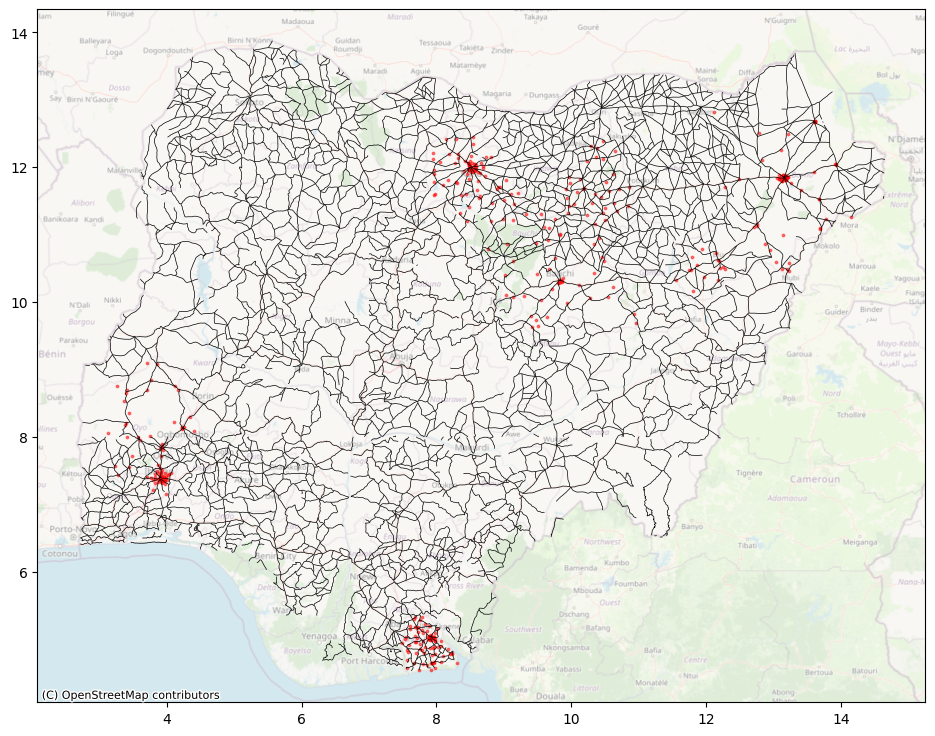

In [12]:
fig, ax = plt.subplots(figsize=(16, 9))

road_ocha['geometry'].plot(color = '#000000',
                       linewidth=0.5,
                       ax = ax)

clusters_gpd84['geometry'].plot(color = 'red',
                                alpha=0.5,
                              markersize = 3,
                              ax = ax)

cx.add_basemap(ax,
               crs=road_ocha['geometry'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


plt.show()

### Displacing Coordinates

This task looks as if it will be a bit more challenging than I expected. I need to displace the cluster coordinates according to the <a href= 'https://dhsprogram.com/pubs/pdf/SAR7/SAR7.pdf'>DHS household survey guidelines</a>. There are a couple of requirements for this:

* urban clusters are displaced a distance up to two kilometers (0-2 km)

* rural clusters are displaced a distance up to five kilometers (0-5 km), with a further, randomly-selected 1% (every 100th) of rural clusters displaced a distance up to 10 kilometers (0-10 km).

</br>

Originally, I had hoped for some kind of in-built command in Shapely or Geopandas which could randomly shift a coordinate by a given distance range (one can dream).

Although, what I am now thinking (since I don't want to convert between degrees and km for a random shift using just the coordinates) is that the best way to do this would be in 2 (3) stages:

1. Create a **buffer** around the clusters, a *2km* buffer for urban clusters, a *5km* buffer for 99% of rural clusters and finally a *10km* buffer for 1% of rural clusters.

2. Then use the **point-in-polygon** method from `Geopandas` to randomly generate one point within each buffer.

3. Check that these points are all within their respective polygons using the `polygon.contains()` command just for piece of mind.

</br>

One choice we need to make here is the Coordinate Reference System (CRS) we use. Since we want to measure distances in meters. After consulting the <a href="epsg.io">EPSG site</a> the most suitable CRS seems to be EPSG:26393 which accurately projects coordinates for the entirety of onshore and some of offshore Nigeria. It has a minimum accuracy of 25m (as in all coordinates are at most 25m out from their true spherical position) in Nigeria and is well documented <a href="https://epsg.io/26393">here</a>

In [13]:
clusters_gpd84.columns

Index(['state', 'cluster', 'urbrur', 'fahe_lat', 'fahe_long', 'geometry'], dtype='object')

In [14]:
#To specify the buffer in meters, we need a crs measured in meters.
clusters_26393 = clusters_gpd84
clusters_26393 = clusters_26393.to_crs(epsg = 26393)

In [15]:
clusters_26393.crs

<Projected CRS: EPSG:26393>
Name: Minna / Nigeria East Belt
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Nigeria east of 10°30'E.
- bounds: (10.49, 6.43, 14.65, 13.72)
Coordinate Operation:
- name: Nigeria East Belt
- method: Transverse Mercator
Datum: Minna
- Ellipsoid: Clarke 1880 (RGS)
- Prime Meridian: Greenwich

In [16]:
import random

In [17]:
#To create the buffers of varying sizes, function which works row by row on the clusters gdf

random.seed(27) #set a random seed so that the random-ness is reproducible

def create_buffer(coord, region):
  if region == 'urban':
    return coord.buffer(2000) #if region is urban, create a 2000m buffer
  elif region == 'rural':
    buffer_sizes = [5000, 10000]  # Radius options for the 'Rural' region
    probabilities = [0.99, 0.01]  # Probability distribution for selecting buffer size
    buffer_size = random.choices(buffer_sizes, probabilities)[0]
    return coord.buffer(buffer_size)
  else:
    return np.nan

clusters_26393['buffer'] = clusters_26393.apply(lambda x: create_buffer(x['geometry'], x['urbrur']), axis=1)

This randomisation method doesn't ensure that 1% of rural buffers are 10km though, there could be more or less than this. As a pseudocode way of doing this, I could first assign a `clusters['1_perc']` which is equal to 1 for 1% of observations with `clusters['___'] == 'Rural'` and then change the function to add a new `if` statement combining the *Rural* and this new *1_perc* condition together to create a 100km buffer.

In [18]:
#Each GeoDataFrame can only have 1 'active' geometry variable at a time, so here i create a second dataframe which
#has an active geometry for the buffers.
clusters_26393_buff = clusters_26393.set_geometry('buffer')

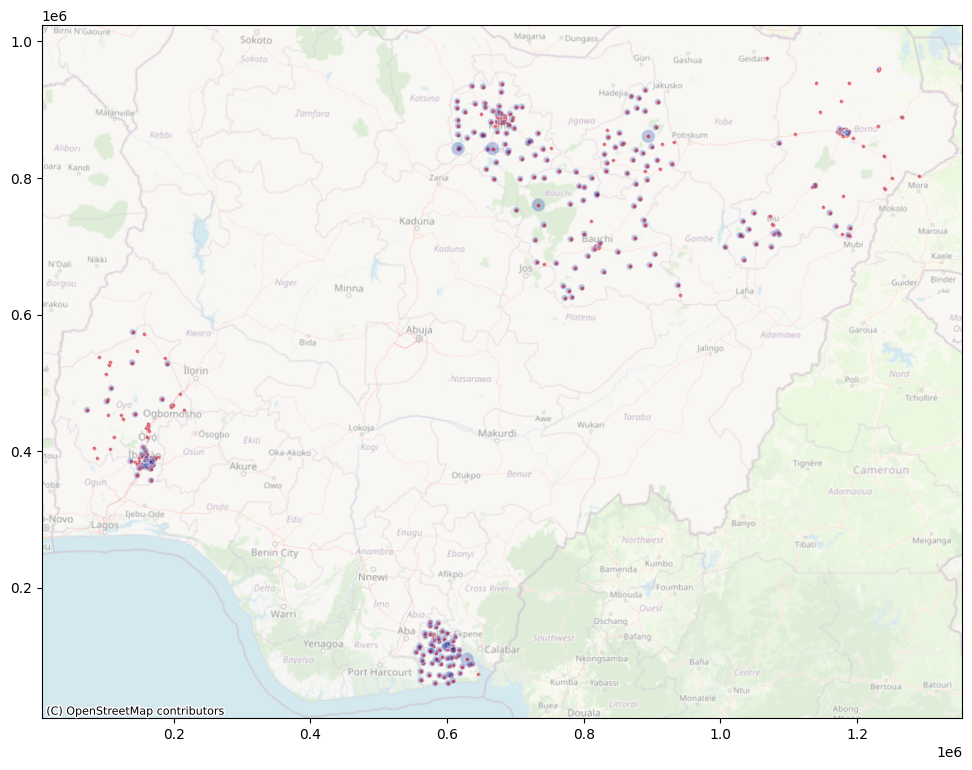

In [19]:
#plotting these buffers with low opacity

fig, ax = plt.subplots(figsize=(16, 9))


clusters_26393['geometry'].plot(color = 'red',
                                alpha=0.5,
                              markersize = 3,
                              ax = ax)

clusters_26393_buff['buffer'].plot(color = '#002fa7',
                              edgecolor = '#FFFFFF',
                              alpha=0.25,
                              ax = ax)


cx.add_basemap(ax,
               crs=clusters_26393['geometry'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


plt.show()

This following cell is **less relevant** now that we have a fully defined rural/urban variable and complete coordinate data, but useful to keep in as a check for the future.

In [20]:

#Before applying the function below, we need all the empty polygon rows to be the same variable type (empty polygon)

def convert_none_to_empty_polygon(df, column):
    # Iterate over the rows in the DataFrame
    for index, row in df.iterrows():
        # Get the value of the 'buffer' column
        buffer_value = row[column]

        # Check if the value is NoneType or an empty polygon
        if buffer_value is None or buffer_value.is_empty:
            # Replace NoneType or empty polygon with an empty polygon
            df.at[index, column] = Polygon()

    return df

# Apply this function to our dataframe
clusters_26393_buff = convert_none_to_empty_polygon(clusters_26393_buff, 'buffer')

In [21]:
#Now to generate one random point within each buffer's min and max x and y (a square around the circle)
#First, the function finds the min and max x and y range of the circle, then generates a random coordinate within
#that range. Then, the x and y and turned into a Point object (a coordinate which can be recognised)
#Finally, the function tests whether the the coordinate is within the buffer, and if it is not, the
#function is re-run until the point lies within the buffer.


random.seed(27) #set a random seed so that the random-ness is reproducible

def Point_In_Bounds(polygon, number):
  if polygon.is_empty == True:
    return np.nan
  else:
    minx, miny, maxx, maxy = polygon.bounds
    x = np.random.uniform(minx, maxx, number )
    y = np.random.uniform(miny, maxy, number )
    disp_point = Point(x, y)
    if polygon.contains(disp_point): #Here we are checking whether the displaced point is within the 'buffer' polygon
      return disp_point
    else:
      return Point_In_Bounds(polygon, number)



In [22]:
#Now we need to create a new dataframe to hold the displaced coords (remember each df can only have 1 'active'
# geometry column). We do this by just applying the above function to each row.
clusters_26393_disp = clusters_26393_buff
clusters_26393_disp['disp_coord'] = clusters_26393_disp.apply(lambda x: Point_In_Bounds(x['buffer'], 1), axis=1)
clusters_26393_disp = clusters_26393_disp.set_geometry('disp_coord')
clusters_26393_disp.crs = "EPSG:26393"

In [23]:
#since we dropped some rows earlier, need to reset index for the next 'for' loop
clusters_26393_buff = clusters_26393_buff.reset_index()
clusters_26393_disp = clusters_26393_disp.reset_index()

In [24]:
# Here we create an indicator variable for where the new coordinate is not within the buffer circle
#If this condition is False, that means we should have no buffer for the given cluster (either because there
# is no coordinate specified, or that cluster has a missing value for 'urbrurMan')
clusters_26393_disp['no_geom'] = np.nan

for i in range(len(clusters_26393_buff)):
  if clusters_26393_buff['buffer'][i].contains(clusters_26393_disp['disp_coord'][i]) == False:
    clusters_26393_disp['no_geom'][i]=1
  else:
    clusters_26393_disp['no_geom'][i]=0

<ipython-input-24-96cc74b76d71>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clusters_26393_disp['no_geom'][i]=0


In [25]:
#this function just shows all the clusters which either have no specified coordinates, or no rural/urban definition
# (hence, no displaced coordinates.)

clusters_26393_disp.loc[clusters_26393_disp['no_geom']==1]

,index,state,cluster,urbrur,fahe_lat,fahe_long,geometry,buffer,disp_coord,no_geom


Now let's plot the original and displaced coordinates on the map. We should see that all the displaced coordinates are each *within a blue circle*. Even though the size of the dots might make them look slightly outside, the above `.loc` check shows us that there are no *displaced coordinates* which are not inside their respective buffer area.  

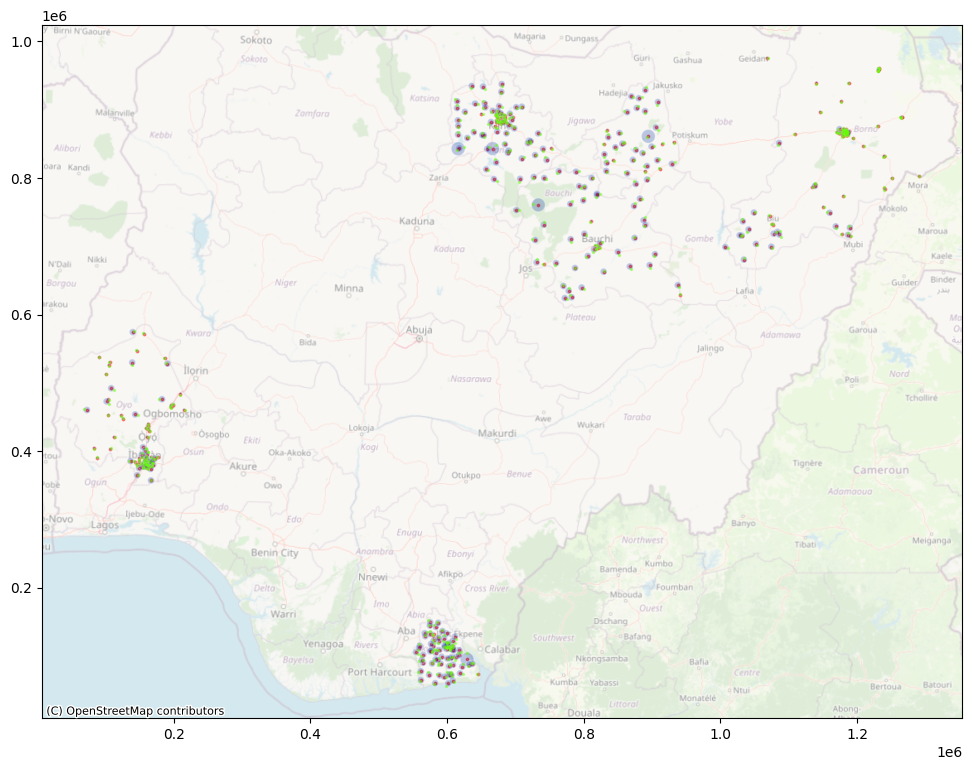

In [26]:
#plotting original coordinates in red, new coordinates in green, and the buffers in blue

fig, ax = plt.subplots(figsize=(16, 9))


clusters_26393['geometry'].plot(color = 'red',
                                alpha=0.5,
                              markersize = 3,
                              ax = ax)

clusters_26393_buff['buffer'].plot(color = '#002fa7',
                              edgecolor = '#FFFFFF',
                              alpha=0.25,
                              ax = ax)


clusters_26393_disp['disp_coord'].plot(color = '#66FF00',
                                alpha=0.4,
                              markersize = 2,
                              ax = ax)

cx.add_basemap(ax,
               crs=clusters_26393['geometry'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


plt.show()

### Distance to Nearest Road

We now want to use our displaced coordinates which are within `clusters_26393_disp` and work out the minimum distance to the nearest road for each cluster.

In [27]:
#firstly, convert the road shapefile into EPSG:26393, which is the crs used for our hosing data.
road_ocha_26393 = road_ocha.to_crs(epsg = 26393)
clusters_26393_disp = clusters_26393_disp.to_crs(epsg = 26393)

In [28]:
def calculate_nearest_distance_line(clusters_df, facility_df, facility_type):
    nearest_distances = []
    lines_to_facility = []

    for point in clusters_df['disp_coord']:
        if point is None:
            nearest_distances.append(np.nan)  # Return NaN if there is no displaced coordinate
            lines_to_facility.append(np.nan)
        else:
            # Find the nearest line (index the facility dataframe with the index no. of the nearest one)
            nearest_line = facility_df['geometry'][facility_df['geometry'].distance(point).idxmin()]

            # Append the line between the cluster and the closest point on the LineString found above (for data vis)
            # Find the nearest road point for the cluster. nearest_points returns a tuple where the first item is
            # the nearest point for 'point' (which is the cluster coordinate) and the second item is the nearest
            # point on the 'nearest_road_line'.
            nearest_point_on_line = nearest_points(point, nearest_line)[1]

            cluster_to_facility = LineString([point, nearest_point_on_line])
            lines_to_facility.append(cluster_to_facility)

            # Calculate the Euclidean distance between the given point and the nearest facility
            distance_to_facility = point.distance(nearest_point_on_line)

            # Append the distance to the nearest facility
            nearest_distances.append(distance_to_facility)

    # Add the nearest distances and lines to the dataset as new columns with dynamic column names
    clusters_df[f'distance_to_{facility_type}_m'] = nearest_distances
    clusters_df[f'line_to_{facility_type}'] = lines_to_facility
    clusters_df_to_facility = clusters_df.set_geometry(f'line_to_{facility_type}')

    return clusters_df_to_facility

In [29]:
#For nearest road of all types:
clusters_26393_disp_any_road = calculate_nearest_distance_line(clusters_26393_disp, road_ocha_26393, facility_type = 'any_road')

Here, we apply the function to subsets of the road dataset for each type of road. The types of roads are:
* 'Other road & track'
* 'Paved federal road'
* 'Other paved road'

and each dataset is named accordingly.

In [30]:
#create a seperate dataset for each road type
road_ocha_26393_track = road_ocha_26393.loc[road_ocha_26393['DESCRIPTIO']=='Other road & track']
road_ocha_26393_federal = road_ocha_26393.loc[road_ocha_26393['DESCRIPTIO']=='Paved federal road']
road_ocha_26393_paved = road_ocha_26393.loc[road_ocha_26393['DESCRIPTIO']=='Other paved road']

In [31]:
print(f'There are {len(road_ocha_26393_federal)} Paved Federal Roads')
print(f'There are {len(road_ocha_26393_paved)} Other Paved Roads')
print(f'There are {len(road_ocha_26393_track)} Other Roads & Tracks')

There are 374 Paved Federal Roads
There are 684 Other Paved Roads
There are 3651 Other Roads & Tracks


In [32]:
#Now applying the function for each road type above

#tracks and other roads
clusters_26393_disp_track_road = calculate_nearest_distance_line(clusters_26393_disp, road_ocha_26393_track, facility_type = 'track_road')

#Paved federal roads
clusters_26393_disp_federal_road = calculate_nearest_distance_line(clusters_26393_disp, road_ocha_26393_federal, facility_type = 'federal_road')

#Other Paved roads
clusters_26393_disp_paved_road = calculate_nearest_distance_line(clusters_26393_disp, road_ocha_26393_paved, facility_type = 'paved_road')


Here we are creating the distance variable for each type of road

In [33]:
# #create a seperate dataset for each road type
# road_ocha_26393_track = road_ocha_26393.loc[road_ocha_26393['DESCRIPTIO']=='Other road & track']
# road_ocha_26393_federal = road_ocha_26393.loc[road_ocha_26393['DESCRIPTIO']=='Paved federal road']
# road_ocha_26393_paved = road_ocha_26393.loc[road_ocha_26393['DESCRIPTIO']=='Other paved road']

In [34]:
# ### Creating a distance for each road type

# #### Paved Federal Road ####
# nearest_distances = []
# for point in clusters_26393_disp['disp_coord']:
#   if point is None:
#     nearest_distances.append(np.nan) #return NaN if there is no dispaced coordinate
#   else:
#     # Find the nearest road line (index the road dataframe with the index no. of the nearest road)
#     nearest_road_line = road_ocha_26393_federal['geometry'][road_ocha_26393_federal['geometry'].distance(point).idxmin()]

#     # Find the nearest road point for the cluster. nearest_points returns a tuple where the first item is
#     # the nearest point for 'point' (which is the cluster coordinate) and the second item is the nearest
#     # point on the 'nearest_road_line'.
#     nearest_point_on_road = nearest_points(point, nearest_road_line)[1]

#     # Calculate the Euclidean distance between the given point and the nearest point on the road line
#     distance_to_road = point.distance(nearest_point_on_road)

#     # Append the distance to the nearest road
#     nearest_distances.append(distance_to_road)

# # Add the nearest distances to the dataset as a new column
# clusters_26393_disp['federal_rd_dist_m'] = nearest_distances


# #### Other Paved Road ####
# nearest_distances = []
# for point in clusters_26393_disp['disp_coord']:
#   if point is None:
#     nearest_distances.append(np.nan) #return NaN if there is no dispaced coordinate
#   else:
#     # Find the nearest road line (index the road dataframe with the index no. of the nearest road)
#     nearest_road_line = road_ocha_26393_paved['geometry'][road_ocha_26393_paved['geometry'].distance(point).idxmin()]

#     # Find the nearest road point for the cluster. nearest_points returns a tuple where the first item is
#     # the nearest point for 'point' (which is the cluster coordinate) and the second item is the nearest
#     # point on the 'nearest_road_line'.
#     nearest_point_on_line = nearest_points(point, nearest_road_line)[1]

#     # Calculate the Euclidean distance between the given point and the nearest point on the road line
#     distance_to_road = point.distance(nearest_point_on_road)

#     # Append the distance to the nearest road
#     nearest_distances.append(distance_to_road)

# # Add the nearest distances to the dataset as a new column
# clusters_26393_disp['paved_rd_dist_m'] = nearest_distances


# #### Other Paved Road ####
# nearest_distances = []
# for point in clusters_26393_disp['disp_coord']:
#   if point is None:
#     nearest_distances.append(np.nan) #return NaN if there is no dispaced coordinate
#   else:
#     # Find the nearest road line (index the road dataframe with the index no. of the nearest road)
#     nearest_road_line = road_ocha_26393_track['geometry'][road_ocha_26393_track['geometry'].distance(point).idxmin()]

#     # Find the nearest road point for the cluster. nearest_points returns a tuple where the first item is
#     # the nearest point for 'point' (which is the cluster coordinate) and the second item is the nearest
#     # point on the 'nearest_road_line'.
#     nearest_point_on_road = nearest_points(point, nearest_road_line)[1]

#     # Calculate the Euclidean distance between the given point and the nearest point on the road line
#     distance_to_road = point.distance(nearest_point_on_road)

#     # Append the distance to the nearest road
#     nearest_distances.append(distance_to_road)

# # Add the nearest distances to the dataset as a new column
# clusters_26393_disp['other_track_rd_dist_m'] = nearest_distances


In [35]:
clusters_26393_disp.head(3)

,index,state,cluster,urbrur,fahe_lat,fahe_long,geometry,buffer,disp_coord,no_geom,distance_to_any_road_m,line_to_any_road,distance_to_track_road_m,line_to_track_road,distance_to_federal_road_m,line_to_federal_road,distance_to_paved_road_m,line_to_paved_road
0,0,bauchi,1.0,rural,10.22240,10.61791,POINT (904247.370 688499.481),"POLYGON ((909247.370 688499.481, 909223.294 68...",POINT (902870.003 685704.168),0.0,8147.399106,LINESTRING (902870.0031577917 685704.168220026...,8147.399106,LINESTRING (902870.0031577917 685704.168220026...,13544.699285,LINESTRING (902870.0031577917 685704.168220026...,57274.547463,LINESTRING (902870.0031577917 685704.168220026...
1,1,bauchi,2.0,rural,9.81436,10.92451,POINT (937629.864 643182.110),"POLYGON ((942629.864 643182.110, 942605.788 64...",POINT (938714.646 640252.535),0.0,205.725613,LINESTRING (938714.6456417881 640252.534631191...,205.725613,LINESTRING (938714.6456417881 640252.534631191...,32486.538867,LINESTRING (938714.6456417881 640252.534631191...,22387.181634,LINESTRING (938714.6456417881 640252.534631191...
2,2,bauchi,3.0,urban,9.68761,10.95771,POINT (941208.380 629144.538),"POLYGON ((943208.380 629144.538, 943198.749 62...",POINT (941075.847 630188.954),0.0,2272.975618,LINESTRING (941075.8472418267 630188.953726266...,2272.975618,LINESTRING (941075.8472418267 630188.953726266...,33938.093171,LINESTRING (941075.8472418267 630188.953726266...,16560.394519,LINESTRING (941075.8472418267 630188.953726266...


To **check** these distances we can create a data visualisation *zooming in* on a certain section of Nigeria where we plot:

* The roads from the shapefile.

* The newly displaced clusters.

* The lines between the roads and the calculated 'nearest point' on the road.

This should visually show that the above `for` loop is working properly and giving us the desired distances.

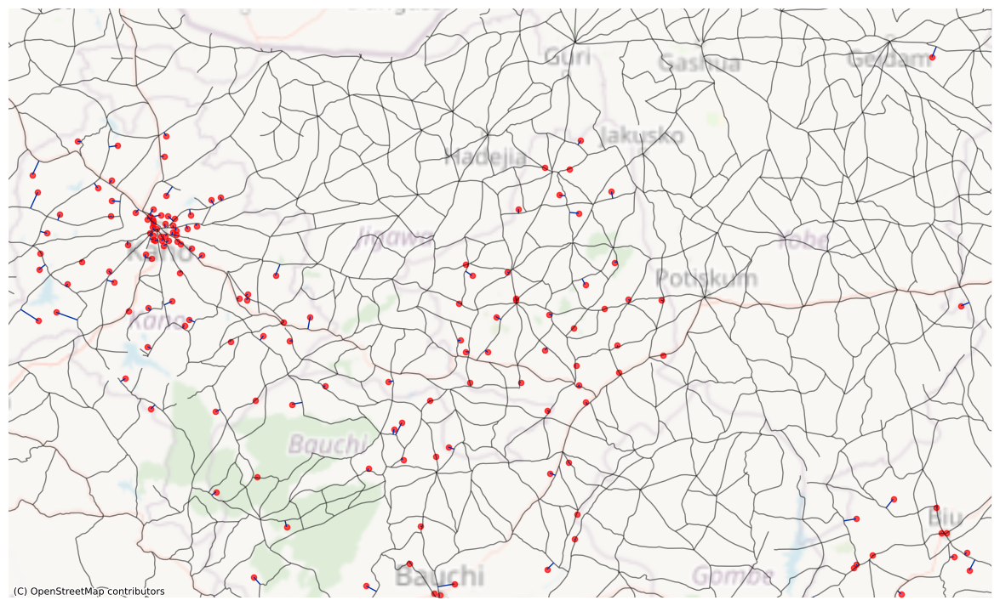

In [36]:
# create a data visualisation of the lines to the nearest roads

fig, ax = plt.subplots(figsize=(16, 9))

#plot the roads from the shapefile in black
road_ocha_26393['geometry'].plot(color = '#000000',
                                 linewidth=1,
                                 alpha=0.5,
                                 ax = ax)

#Plot the newly displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 20,
                                       ax = ax)

#plot the lines between the clusters and the roads in blue
clusters_26393_disp_any_road['line_to_any_road'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=1,
                                             ax = ax)

cx.add_basemap(ax,
               crs = road_ocha_26393['geometry'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)

#Set axes limits to 'zoom in' on North Eastern Nigeria
ax.set_ylim(0.7e+6, 1.0e+6)
ax.set_xlim(0.6e+6, 1.1e+6)
ax.set_axis_off()
plt.show()

#### Creating an Interractive version of the map

We can use `folium` to create an interractive map. There is a range of style options which can be found <a href="https://leafletjs.com/reference.html#path-option">here</a> to customise the lines and markers on the map.

In [37]:
# necessary imports for the interractive map

!pip install mapclassify
!pip install folium
from mapclassify import classify
import folium

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 kB 1.3 MB/s eta 0:00:00


In [38]:
#these previously had an empty CRS
clusters_26393_disp.crs = "EPSG:26393"
clusters_26393_disp_any_road.crs = "EPSG:26393"

In [39]:
# need to first set the crs to a degree unit crs so that the coordinates can be plotted properly.
clusters_84_disp = clusters_26393_disp.to_crs("WGS 84")
clusters_84_disp_any_road =  clusters_26393_disp_any_road.to_crs("WGS 84")
road_ocha_84 = road_ocha_26393.to_crs("wGS 84")

In [40]:
m = folium.Map(location=[9.0820, 8.6753], zoom_start=6, control_scale=True)

folium.GeoJson(road_ocha_84['geometry'],
               name='Roads',
               style_function=lambda x: {'color': '#000000',
                                         'opacity': 0.4,
                                         'weight':1.5}).add_to(m)

#to avoid the ugly default markers, create a function to
def plotDot(point):
    if point.disp_coord is None:
      pass
    if int(point.cluster) in [339, 340, 341]:
      folium.CircleMarker(location=[point.disp_coord.y, point.disp_coord.x],
                          tooltip=[point.state, point.cluster],
                    radius=2,
                    opacity=1,
                    color = '#32CD32',
                    fill=True,).add_to(m)
    else:
      folium.CircleMarker(location=[point.disp_coord.y, point.disp_coord.x],
                          tooltip=[point.state, point.cluster],
                    radius=2,
                    opacity=1,
                    color = '#EE4B2B',
                    fill=True,).add_to(m)

#iterates through every row of the dataframe, plotting each point.
clusters_26393_disp.apply(plotDot, axis = 1)

# folium.GeoJson(clusters_26393_disp['disp_coord'],
#                name='Cluster Coordinates',
#                style_function=lambda x: {'color': 'red',
#                                          'weight':0.5}).add_to(m)

folium.GeoJson(clusters_84_disp_any_road['line_to_any_road'],
               name='Lines to Road',
               style_function=lambda x: {'color': '#002fa7', 'opacity':0.7}).add_to(m)

folium.LayerControl().add_to(m)

#Get the HTML to create the map in a shareable web page
map_html = m._repr_html_()

m

### Distance to Nearest Feature

Here, we want to uncover the distance between each cluster and a range of services which correlate with health factors.

#### Health Facilities

The first dataset covers Primary, Secondary, and Tertiary health facilities in Nigieria. It is from the <a href = "https://data.humdata.org/dataset/nigeria-health-facilities">OCHA</a>. This is a relatively large file so I will download it straight into the Colab notebook.
<br>
<br>
This dataset contains information on 46,146 health facilities. The `type` variable covers different types of health facilities:
* 'Primary' (43,970 facilities),
* 'Secondary' (1,338 facilities),
* 'Tertiary' (800 facilities),
* 'Primary Health Clinic' (15 facilities),
* 'Health Post Dispensary' (13 facilities),
* 'Unknown' (6 facilities),
* 'Primary Health Center' (4 facilities).

Initially, we can map the Primary Health Centers to be 'primary' since these appear to be labelled incorrectly (a number of 'Primary' type facilities have 'Primary Health Center' as their `category` variable).
<br>
<br>
We also have the `category` variable for different facility types:
* Primary Health Center               (28,031)
* Dispensary                           (8,626)
* Maternity Home                       (4,423)
* Private Non Profit                   (1,179)
* Medical Center                        (956)
* Specialist Hospital                   (673)
* General Hospital                      (637)
* Comprehensive Health Center           (458)
* Educational Clinic                    (249)
* Laboratory                            (234)
* Cottage Hospital                      (223)
* Military and Paramilitary Clinic      (143)
* Federal Staff Clinic                  (110)
* Teaching Hospital                      (51)
* Federal Medical Center                 (46)
* District Hospital                      (25)
* Pharmacy                               (21)
* Veterinary Clinic                      (14)
* Community Health Center                 (8)
* Others                                  (4)
* Research Hospital                       (1)


In [41]:
#read in the json file from the OCHR source
url = requests.get('https://data.humdata.org/dataset/3b4a119a-309c-4d3f-900f-18a1f6ca2dfa/resource/5a3bdd13-3ada-4bf4-ac38-643390bc0562/download/nigeriahealthfacilities.json')
url_content = url.content

In [42]:
#Create a json file to write the requested content above into.
facilities_json = open('health_facilities.json', 'wb')
facilities_json.write(url_content)
facilities_json.close()

In [43]:
#load the data into a GeoDataFrame.
facilities_df = gpd.read_file('health_facilities.json')

In [44]:
facilities_df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [45]:
facilities_df.head(5)

,id,name,global_id,alternate_name,functional_status,type,ward_code,category,timestamp,accessibility,lga_name,lga_code,state_code,state_name,geometry
0,1,G R A Nursing Home,af719462-abfd-4f47-9dc3-0987164e75ac,Nursing Home,Unknown,Primary,12413,Primary Health Center,2020-07-04 13:49:18+00:00,NaN,Maiduguri,124,BR,Borno,POINT (13.14832 11.82232)
1,2,Gishili Health Center,a29b0328-d844-4358-b0ab-2e120b8fb30f,Nursing Home,Functional,Primary,12413,Primary Health Center,2020-07-04 13:49:18+00:00,Unknown,Maiduguri,124,BR,Borno,POINT (13.14718 11.82161)
2,3,Lehobi Primary Health Care,b685b769-5c83-4f83-a182-00e7e1b777d8,NaN,Partially Functional,Primary,10207,Primary Health Center,2020-07-04 13:49:18+00:00,NaN,Askira Uba,102,BR,Borno,POINT (12.81628 10.70709)
3,4,Dugja Idp Camp,78e64f7a-cbb8-4357-9e64-a7e502534527,Mandara Girau Dispensary,Not Functional,Primary,10503,Primary Health Center,2020-07-04 13:49:18+00:00,Unknown,Biu,105,BR,Borno,POINT (12.18163 10.61522)
4,5,Kopa Maikudiri Dispensary,409c97ce-7490-4dc2-a8f8-2b8d53ad2b12,NaN,Partially Functional,Primary,10209,Dispensary,2020-07-04 13:49:18+00:00,Unknown,Askira Uba,102,BR,Borno,POINT (13.31336 10.75953)


In [46]:
facilities_df['category'].value_counts()

Primary Health Center               28031
Dispensary                           8626
Maternity Home                       4423
Private Non Profit                   1179
Medical Center                        956
Specialist Hospital                   673
General Hospital                      637
Comprehensive Health Center           458
Educational Clinic                    249
Laboratory                            234
Cottage Hospital                      223
Military and Paramilitary Clinic      143
Federal Staff Clinic                  110
Teaching Hospital                      51
Federal Medical Center                 46
District Hospital                      25
Pharmacy                               21
Veterinary Clinic                      14
Community Health Center                 8
Others                                  4
Research Hospital                       1
Name: category, dtype: int64

In [47]:
facilities_df['geometry'] = facilities_df['geometry'].to_crs(epsg = 26393)
clusters_26393_disp['disp_coord'] = clusters_26393_disp['disp_coord'].to_crs(epsg = 26393)

In [48]:
#Defining a function to calculate the nearest distances from clusters_df to a given facility df

def calculate_nearest_distance_point(clusters_df, facility_df, facility_type):
    nearest_distances = []
    lines_to_facility = []

    for point in clusters_df['disp_coord']:
        if point is None:
            nearest_distances.append(np.nan)  # Return NaN if there is no displaced coordinate
            lines_to_facility.append(np.nan)
        else:
            # Find the nearest health facility (index the facility dataframe with the index no. of the nearest one)
            nearest_facility = facility_df['geometry'][facility_df['geometry'].distance(point).idxmin()]

            # Append the line between the cluster and the nearest point on the road (for data vis)
            cluster_to_facility = LineString([point, nearest_facility])
            lines_to_facility.append(cluster_to_facility)

            # Calculate the Euclidean distance between the given point and the nearest facility
            distance_to_facility = point.distance(nearest_facility)

            # Append the distance to the nearest facility
            nearest_distances.append(distance_to_facility)

    # Add the nearest distances and lines to the dataset as new columns with dynamic column names
    clusters_df[f'distance_to_{facility_type}_m'] = nearest_distances
    clusters_df[f'line_to_{facility_type}'] = lines_to_facility
    clusters_df_to_facility = clusters_df.set_geometry(f'line_to_{facility_type}')

    return clusters_df_to_facility


In [49]:
clusters_26393_disp_health = calculate_nearest_distance_point(clusters_26393_disp, facilities_df, facility_type='health')
clusters_26393_disp_health.crs = clusters_26393_disp['disp_coord'].crs

In [50]:
clusters_26393_disp_health.head(3)

,index,state,cluster,urbrur,fahe_lat,fahe_long,geometry,buffer,disp_coord,no_geom,distance_to_any_road_m,line_to_any_road,distance_to_track_road_m,line_to_track_road,distance_to_federal_road_m,line_to_federal_road,distance_to_paved_road_m,line_to_paved_road,distance_to_health_m,line_to_health
0,0,bauchi,1.0,rural,10.22240,10.61791,POINT (904247.370 688499.481),"POLYGON ((909247.370 688499.481, 909223.294 68...",POINT (902870.003 685704.168),0.0,8147.399106,LINESTRING (902870.0031577917 685704.168220026...,8147.399106,LINESTRING (902870.0031577917 685704.168220026...,13544.699285,LINESTRING (902870.0031577917 685704.168220026...,57274.547463,LINESTRING (902870.0031577917 685704.168220026...,3221.205288,"LINESTRING (902870.003 685704.168, 904504.932 ..."
1,1,bauchi,2.0,rural,9.81436,10.92451,POINT (937629.864 643182.110),"POLYGON ((942629.864 643182.110, 942605.788 64...",POINT (938714.646 640252.535),0.0,205.725613,LINESTRING (938714.6456417881 640252.534631191...,205.725613,LINESTRING (938714.6456417881 640252.534631191...,32486.538867,LINESTRING (938714.6456417881 640252.534631191...,22387.181634,LINESTRING (938714.6456417881 640252.534631191...,5324.237715,"LINESTRING (938714.646 640252.535, 936141.534 ..."
2,2,bauchi,3.0,urban,9.68761,10.95771,POINT (941208.380 629144.538),"POLYGON ((943208.380 629144.538, 943198.749 62...",POINT (941075.847 630188.954),0.0,2272.975618,LINESTRING (941075.8472418267 630188.953726266...,2272.975618,LINESTRING (941075.8472418267 630188.953726266...,33938.093171,LINESTRING (941075.8472418267 630188.953726266...,16560.394519,LINESTRING (941075.8472418267 630188.953726266...,423.205851,"LINESTRING (941075.847 630188.954, 940697.321 ..."


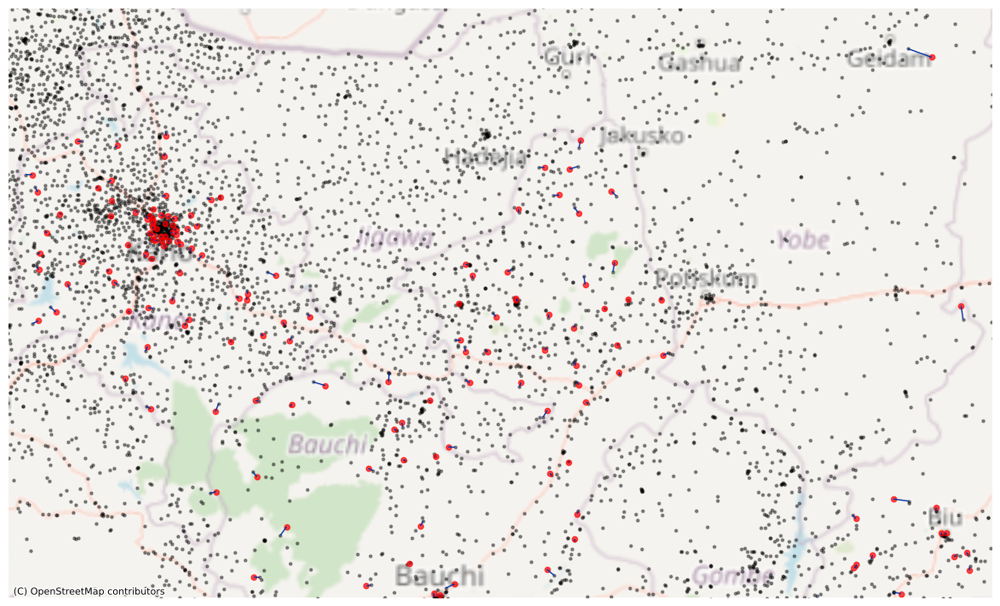

In [51]:
# create a data visualisation of the lines to the nearest health facilities

fig, ax = plt.subplots(figsize=(16, 9))

#plot the roads from the shapefile in black
facilities_df['geometry'].plot(color = '#000000',
                               alpha=0.4,
                               markersize = 5,
                               ax = ax)

#Plot the newly displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 20,
                                       ax = ax)

#plot the lines between the clusters and the roads in blue
clusters_26393_disp_health['line_to_health'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=1,
                                             ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp_health['line_to_health'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)

#Set axes limits to 'zoom in' on North Eastern Nigeria
ax.set_ylim(0.7e+6, 1.0e+6)
ax.set_xlim(0.6e+6, 1.1e+6)
ax.set_axis_off()
plt.show()

In [52]:
clusters_26393_disp.head(3)

,index,state,cluster,urbrur,fahe_lat,fahe_long,geometry,buffer,disp_coord,no_geom,distance_to_any_road_m,line_to_any_road,distance_to_track_road_m,line_to_track_road,distance_to_federal_road_m,line_to_federal_road,distance_to_paved_road_m,line_to_paved_road,distance_to_health_m,line_to_health
0,0,bauchi,1.0,rural,10.22240,10.61791,POINT (904247.370 688499.481),"POLYGON ((909247.370 688499.481, 909223.294 68...",POINT (902870.003 685704.168),0.0,8147.399106,LINESTRING (902870.0031577917 685704.168220026...,8147.399106,LINESTRING (902870.0031577917 685704.168220026...,13544.699285,LINESTRING (902870.0031577917 685704.168220026...,57274.547463,LINESTRING (902870.0031577917 685704.168220026...,3221.205288,LINESTRING (902870.0031577917 685704.168220026...
1,1,bauchi,2.0,rural,9.81436,10.92451,POINT (937629.864 643182.110),"POLYGON ((942629.864 643182.110, 942605.788 64...",POINT (938714.646 640252.535),0.0,205.725613,LINESTRING (938714.6456417881 640252.534631191...,205.725613,LINESTRING (938714.6456417881 640252.534631191...,32486.538867,LINESTRING (938714.6456417881 640252.534631191...,22387.181634,LINESTRING (938714.6456417881 640252.534631191...,5324.237715,LINESTRING (938714.6456417881 640252.534631191...
2,2,bauchi,3.0,urban,9.68761,10.95771,POINT (941208.380 629144.538),"POLYGON ((943208.380 629144.538, 943198.749 62...",POINT (941075.847 630188.954),0.0,2272.975618,LINESTRING (941075.8472418267 630188.953726266...,2272.975618,LINESTRING (941075.8472418267 630188.953726266...,33938.093171,LINESTRING (941075.8472418267 630188.953726266...,16560.394519,LINESTRING (941075.8472418267 630188.953726266...,423.205851,LINESTRING (941075.8472418267 630188.953726266...


#### Education Facilities

There are 2 datasets available but the second (<a href="https://africaopendata.org/dataset/nigeria-secondary-schools">Open Africa</a>) does not seem to work properly. When attemptin to access the data there is a 404 error.

In [53]:
#read in the json file from the OCHR source
url = requests.get('https://export.hotosm.org/downloads/130c5517-bf9d-4734-912e-7ebfc41e89a9/hotosm_nga_education_facilities_points_shp.zip')

In [54]:
with open("shapefile.zip", "wb") as file:
    file.write(url.content)

In [55]:
with zipfile.ZipFile("shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("shapefile")

In [56]:
shapefile_path = "shapefile/hotosm_nga_education_facilities_points.shp"
education_df = gpd.read_file(shapefile_path)

In [57]:
#convert the gpd into our EPSG:26393 CRS which is measured in meters
education_df_26393 = education_df.to_crs(epsg = 26393)
clusters_26393_disp = clusters_26393_disp.to_crs(epsg = 26393)

In [58]:
clusters_26393_disp_educ = calculate_nearest_distance_point(clusters_26393_disp, education_df_26393, facility_type='educ')
clusters_26393_disp_educ.crs = clusters_26393_disp['disp_coord'].crs

In [59]:
clusters_26393_disp_educ.head(3)

,index,state,cluster,urbrur,fahe_lat,fahe_long,geometry,buffer,disp_coord,no_geom,...,distance_to_track_road_m,line_to_track_road,distance_to_federal_road_m,line_to_federal_road,distance_to_paved_road_m,line_to_paved_road,distance_to_health_m,line_to_health,distance_to_educ_m,line_to_educ
0,0,bauchi,1.0,rural,10.22240,10.61791,POINT (904247.370 688499.481),"POLYGON ((909247.370 688499.481, 909223.294 68...",POINT (902870.003 685704.168),0.0,...,8147.399106,LINESTRING (902870.0031577917 685704.168220026...,13544.699285,LINESTRING (902870.0031577917 685704.168220026...,57274.547463,LINESTRING (902870.0031577917 685704.168220026...,3221.205288,LINESTRING (902870.0031577917 685704.168220026...,50144.342284,"LINESTRING (902870.003 685704.168, 951993.525 ..."
1,1,bauchi,2.0,rural,9.81436,10.92451,POINT (937629.864 643182.110),"POLYGON ((942629.864 643182.110, 942605.788 64...",POINT (938714.646 640252.535),0.0,...,205.725613,LINESTRING (938714.6456417881 640252.534631191...,32486.538867,LINESTRING (938714.6456417881 640252.534631191...,22387.181634,LINESTRING (938714.6456417881 640252.534631191...,5324.237715,LINESTRING (938714.6456417881 640252.534631191...,27602.184215,"LINESTRING (938714.646 640252.535, 965560.301 ..."
2,2,bauchi,3.0,urban,9.68761,10.95771,POINT (941208.380 629144.538),"POLYGON ((943208.380 629144.538, 943198.749 62...",POINT (941075.847 630188.954),0.0,...,2272.975618,LINESTRING (941075.8472418267 630188.953726266...,33938.093171,LINESTRING (941075.8472418267 630188.953726266...,16560.394519,LINESTRING (941075.8472418267 630188.953726266...,423.205851,LINESTRING (941075.8472418267 630188.953726266...,29514.955968,"LINESTRING (941075.847 630188.954, 965560.301 ..."


In [60]:
############ OUTDATED BECAUSE OF THE FUNCTION ###################

# nearest_distances = []
# lines_to_facility = []

# for point in clusters_26393_disp['disp_coord']:
#   if point is None:
#     nearest_distances.append(np.nan) #return NaN if there is no dispaced coordinate
#     lines_to_facility.append(np.nan)
#   else:
#     # Find the nearest health facility (index the facility dataframe with the index no. of the nearest one)
#     nearest_facility = education_df['geometry'][education_df['geometry'].distance(point).idxmin()]

#     #append the line between the cluster and the nearest point on the road (for data vis)
#     cluster_to_educ = LineString([point, nearest_facility])
#     lines_to_facility.append(cluster_to_educ)

#     # Calculate the Euclidean distance between the given point and the nearest facility
#     distance_to_facility = point.distance(nearest_facility)

#     # Append the distance to the nearest facility
#     nearest_distances.append(distance_to_facility)

# # Add the nearest distances to the dataset as a new column
# clusters_26393_disp['educ_dist_m'] = nearest_distances
# clusters_26393_disp['educ_line'] = lines_to_facility
# clusters_26393_disp_educ = clusters_26393_disp
# clusters_26393_disp_educ = clusters_26393_disp_educ.set_geometry('educ_line')

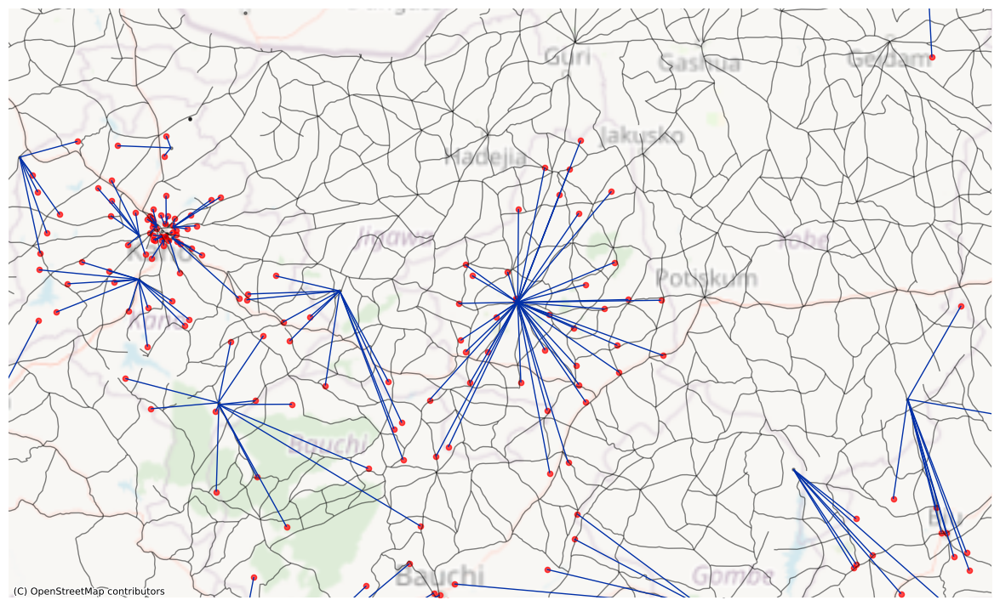

In [61]:
# create a data visualisation of the lines to the nearest education centers

fig, ax = plt.subplots(figsize=(16, 9))

#plot the roads from the shapefile in black
road_ocha_26393['geometry'].plot(color = '#000000',
                                 linewidth=1,
                                 alpha=0.5,
                                 ax = ax)

#plot the education facilities in an opaque grey
education_df_26393['geometry'].plot(color = '#000000',
                               alpha=0.4,
                               markersize = 5,
                               ax = ax)

#Plot the newly displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 20,
                                       ax = ax)

#plot the lines between the clusters and the roads in blue
clusters_26393_disp_educ['line_to_educ'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=1,
                                             ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp_educ['line_to_educ'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)

#Set axes limits to 'zoom in' on North Eastern Nigeria
ax.set_ylim(0.7e+6, 1.0e+6)
ax.set_xlim(0.6e+6, 1.1e+6)
ax.set_axis_off()
plt.show()

In [62]:
clusters_26393_disp['distance_to_educ_m'].max()

127085.12621531182

#### State Capitals


I'm assuming it's EPSG:4326 since that's what the other WB shapefiles are in and is a WB standard. **Question here: Do we want the distance to the nearest state capital, or do we want to calculate the distance from the custer to their own state's capital?**

In [63]:
#read in the zip file from the WB source
url = requests.get('https://datacatalogfiles.worldbank.org/ddh-published/0041737/DR0052168/nga_statecapitals.zip')

In [64]:
with open("capitals_shapefile.zip", "wb") as file:
    file.write(url.content)

In [65]:
with zipfile.ZipFile("capitals_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("capitals_shapefile")

In [66]:
shapefile_path = "/content/capitals_shapefile/nigeria_states capital.shp"
capitals_df = gpd.read_file(shapefile_path)

In [67]:
#setting the CRS as the WB Standard WGS 84
capitals_df.crs = "WGS 84"

In [68]:
#creating a new dataframe with a CRS in meters units
capitals_df_26393 = capitals_df.to_crs(clusters_26393_disp.crs)

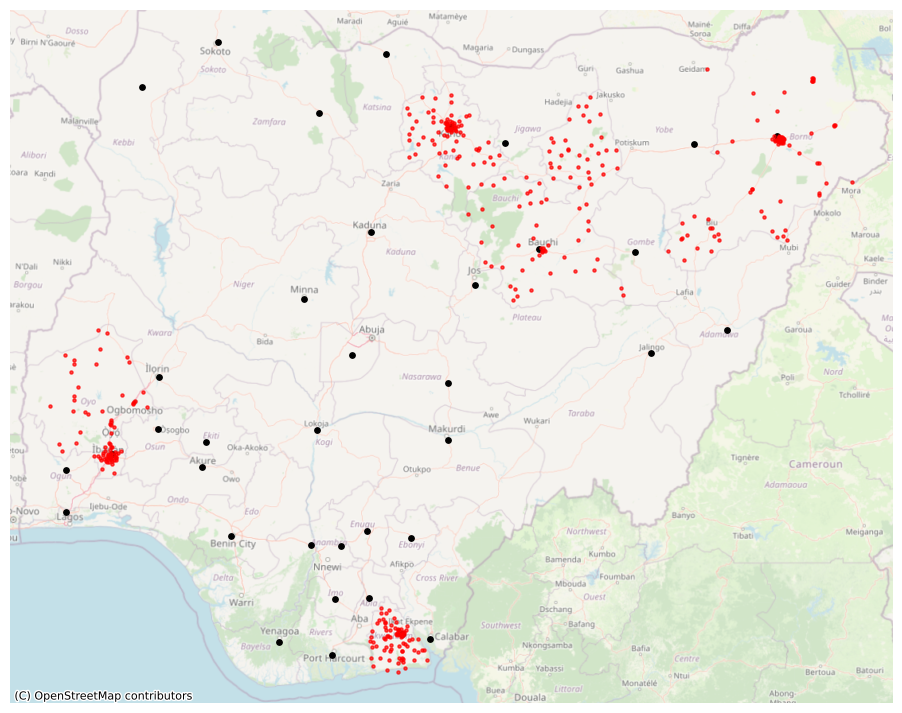

In [69]:
# create a visualisation of where the capitals and clusters are

fig, ax = plt.subplots(figsize=(16, 9))

#plot the capitals from the shapefile in black
capitals_df_26393['geometry'].plot(color = '#000000',
                               alpha=1,
                               markersize = 15,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 5,
                                       ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


ax.set_axis_off()
plt.show()

In [70]:
#Applying the function to find the distance to the nearest capital for each cluster

clusters_26393_disp_capitals = calculate_nearest_distance_point(clusters_26393_disp, capitals_df_26393, facility_type='state_capital')
clusters_26393_disp_capitals.crs = clusters_26393_disp['disp_coord'].crs

In [71]:
clusters_26393_disp['distance_to_state_capital_m'].max()

159199.82548887766

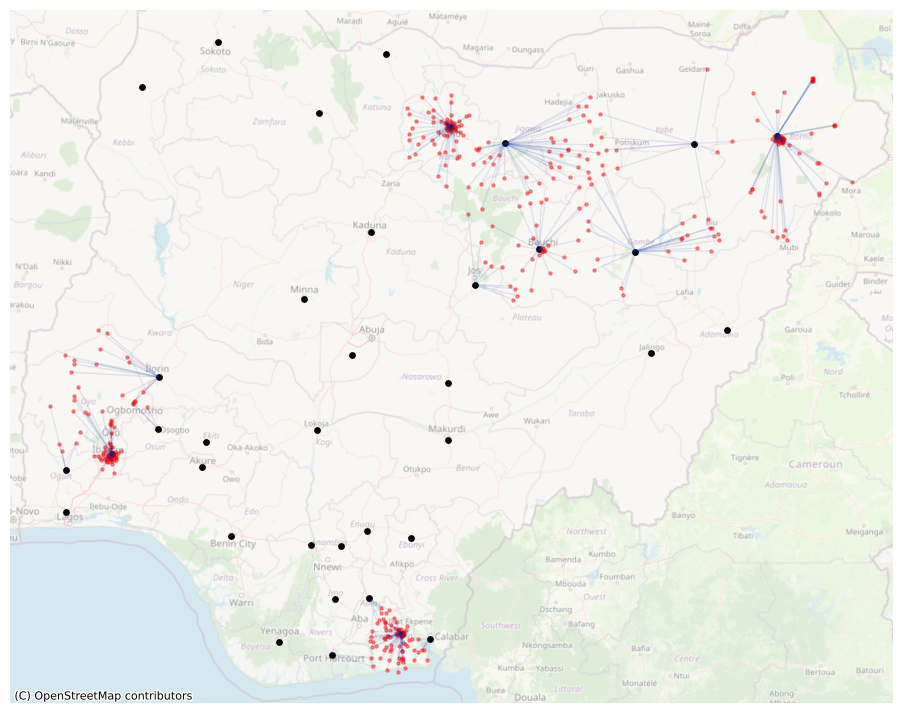

In [72]:
# create a data visualisation of the lines to the nearest capitals

fig, ax = plt.subplots(figsize=(16, 9))

#plot the capitals in an black
capitals_df_26393['geometry'].plot(color = '#000000',
                               alpha=1,
                               markersize = 15,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.4,
                                       markersize = 5,
                                       ax = ax)

#plot the lines between the clusters and the capitals in an opaque blue
clusters_26393_disp_capitals['line_to_state_capital'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=0.1,
                                             ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp_capitals['line_to_state_capital'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


ax.set_axis_off()
plt.show()

#### Irrigation Sites

This dataset provides **polygons** to show the geographic coverage of each irrigation sites as well as a `Sph_Area` variable to give the area of each irrigation site.

Since we are now using **polygons** rather than **coordinates** or **lines** we need to define a new function to find the distance to the nearest irrigation area.

In [73]:
#read in the zip file from the WB source
url = requests.get('https://datacatalogfiles.worldbank.org/ddh-published/0041080/DR0051235/nga_irrigation_sites.zip')

In [74]:
url

<Response [200]>

In [75]:
with open("irrigation_shapefile.zip", "wb") as file:
    file.write(url.content)

In [76]:
with zipfile.ZipFile("irrigation_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("irrigation_shapefile")

In [77]:
#Get the path to the shapefile within the unzipped folder
shapefile_path = "/content/irrigation_shapefile/Irrigation_Sites.shp"
#read that shapefile into a GeoDataFrame using GeoPandas
irrigation_df = gpd.read_file(shapefile_path)

In [78]:
irrigation_df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [79]:
irrigation_df

,Id,Sph_Area,Area,geometry
0,0,4.482792e+06,0.0,"POLYGON ((6.99303 4.97962, 6.99559 4.97942, 6...."
1,0,5.773513e+06,0.0,"POLYGON ((6.95055 4.96408, 6.95370 4.95995, 6...."
2,0,5.702627e+06,0.0,"POLYGON ((6.97926 4.93064, 6.98084 4.92415, 6...."
3,0,5.248804e+06,0.0,"POLYGON ((7.01054 4.88403, 7.01368 4.88187, 7...."
4,0,2.220599e+06,0.0,"POLYGON ((7.00464 4.84981, 7.00739 4.84804, 7...."
...,...,...,...,...
1081,0,2.105159e+08,0.0,"POLYGON ((7.10658 7.89930, 7.10658 7.89914, 7...."
1082,0,1.990685e+08,0.0,"POLYGON ((7.43560 8.05020, 7.43590 8.05007, 7...."
1083,0,2.522896e+07,0.0,"POLYGON ((8.78184 7.75188, 8.78184 7.75182, 8...."
1084,0,3.091382e+08,0.0,"POLYGON ((8.83854 7.81266, 8.83854 7.81266, 8...."


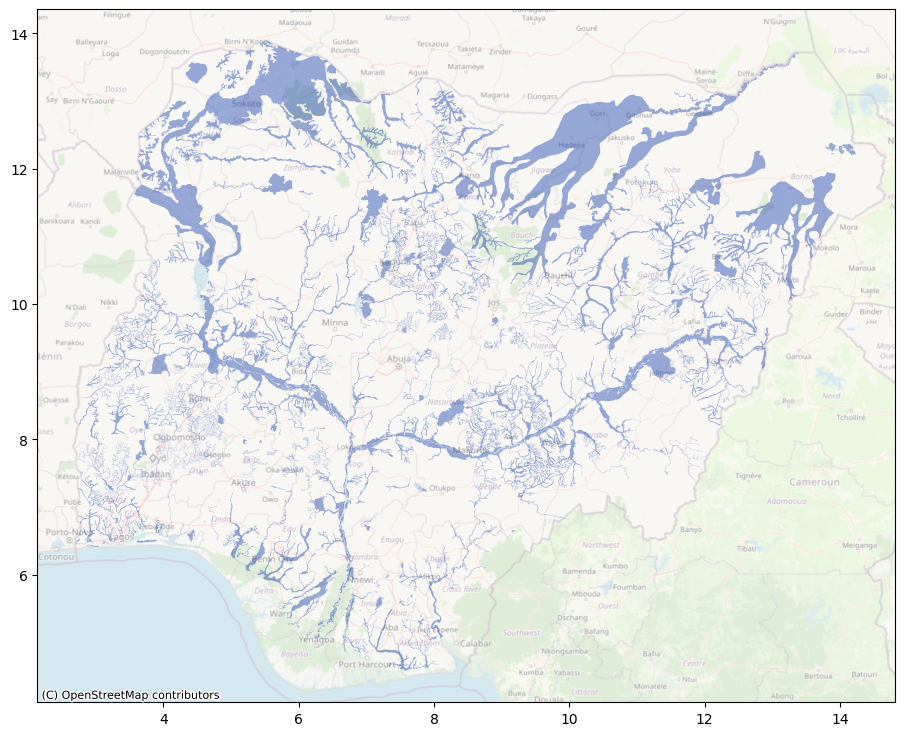

In [80]:
#Plotting a static map

fig, ax = plt.subplots(figsize=(16, 9))




irrigation_df['geometry'].plot(alpha=0.4,
                               facecolor='#002fa7',
                              linewidth=0,
                              ax = ax)


cx.add_basemap(ax,
               crs=irrigation_df.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


plt.show()

We can see that the irrigation sites cover a significant amount of area. Since we want to know the distance between our cluster coordinates and the 'closest' irrigation site. I will assume that **if the cluster is within an irrigation site, the distance should be 0** this implicit assumption is made because I am using the function `nearest_points(poly, cluster)` instead of `nearest_points(poly.boundary, cluster`. If the opposite is required (i.e. distance to nearest irrigation site boundary) then the code can be changed as seen above.

In [81]:
irrigation_df_26393 = irrigation_df.to_crs(epsg = 26393)

In [82]:
# p1, p2 = nearest_points(clusters_26393_disp['disp_coord'][1], irrigation_df_26393['geometry'])
# print(p2)

nearest_facility = irrigation_df_26393['geometry'][irrigation_df_26393['geometry'].distance(clusters_26393_disp['disp_coord'][1]).idxmin()]
#nerest_points() returns a tuple, so the first point is the cluster coordinate, and the second point is the nearest
#point on the polygon (because I put the polygon 'nearest_facility' as the second input in the function)
nearest_point = nearest_points(clusters_26393_disp['disp_coord'][10], nearest_facility)
cluster_to_facility = LineString([nearest_point[0], nearest_point[1]])
distance_to_facility = nearest_point[0].distance(nearest_point[1])
print(f'The closest point to {clusters_26393_disp["disp_coord"][10]} is {nearest_point[1]} which is {distance_to_facility}m away')

The closest point to POINT (821286.4223741937 698378.202197413) is POINT (904648.574790071 619621.8995860149) which is 114681.31345788669m away


In [83]:
#Defining a function to calculate the nearest distances from clusters_df to the areas in irrigation_df

def calculate_nearest_distance_area(clusters_df, facility_df, facility_type):
    nearest_distances = []
    lines_to_facility = []

    for point in clusters_df['disp_coord']:
        if point is None:
            nearest_distances.append(np.nan)  # Return NaN if there is no displaced coordinate
            lines_to_facility.append(np.nan)
        else:
            # Find the nearest health facility (index the facility dataframe with the index no. of the nearest one)
            nearest_facility = facility_df['geometry'][facility_df['geometry'].distance(point).idxmin()]

            #Calculate the nearest points between the cluster and the nearest_facility (closest polygon)
            nearest_point = nearest_points(point, nearest_facility)

            # Append the line between the cluster (nearest_spoint[0]) and the nearest point on the polygon (...[1])
            cluster_to_facility = LineString([nearest_point[0], nearest_point[1]])
            lines_to_facility.append(cluster_to_facility)

            # Calculate the Euclidean distance between the given point and the nearest point on the polygon
            distance_to_facility = nearest_point[0].distance(nearest_point[1])
            # Append the distance to the nearest facility
            nearest_distances.append(distance_to_facility)

    # Add the nearest distances and lines to the dataset as new columns with dynamic column names
    clusters_df[f'distance_to_{facility_type}_m'] = nearest_distances
    clusters_df[f'line_to_{facility_type}'] = lines_to_facility
    clusters_df_to_facility = clusters_df.set_geometry(f'line_to_{facility_type}')

    return clusters_df_to_facility

In [84]:
clusters_26393_disp_irri = calculate_nearest_distance_area(clusters_26393_disp, irrigation_df_26393, facility_type='irrigation')
clusters_26393_disp_irri.crs = clusters_26393_disp.crs

In [85]:
clusters_26393_disp_irri.columns

Index(['index', 'state', 'cluster', 'urbrur', 'fahe_lat', 'fahe_long',
       'geometry', 'buffer', 'disp_coord', 'no_geom', 'distance_to_any_road_m',
       'line_to_any_road', 'distance_to_track_road_m', 'line_to_track_road',
       'distance_to_federal_road_m', 'line_to_federal_road',
       'distance_to_paved_road_m', 'line_to_paved_road',
       'distance_to_health_m', 'line_to_health', 'distance_to_educ_m',
       'line_to_educ', 'distance_to_state_capital_m', 'line_to_state_capital',
       'distance_to_irrigation_m', 'line_to_irrigation'],
      dtype='object')

In [86]:
clusters_26393_to_irrigation = clusters_26393_disp.set_geometry('line_to_irrigation')
clusters_26393_to_irrigation.crs = clusters_26393_disp.crs

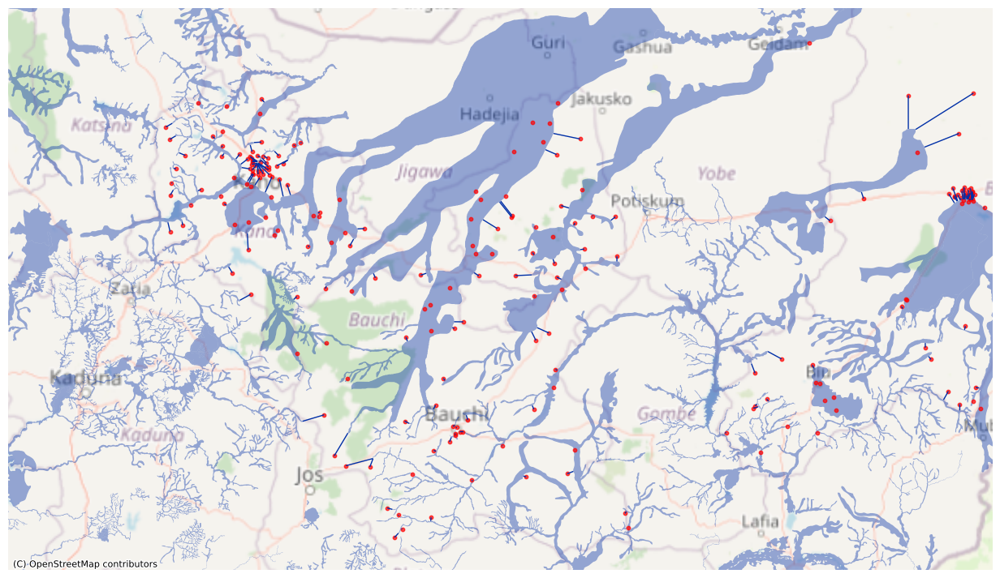

In [87]:
# create a data visualisation showing the lines between clusters and irrigation sites

fig, ax = plt.subplots(figsize=(16, 9))


#plot the education facilities in an opaque grey
irrigation_df_26393['geometry'].plot(alpha=0.4,
                                     facecolor='#002fa7',
                                     linewidth=0,
                                     ax = ax)

#Plot the newly displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 10,
                                       ax = ax)

#plot the lines between the clusters and the roads in blue
clusters_26393_to_irrigation['line_to_irrigation'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=1,
                                             ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_to_irrigation['line_to_irrigation'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.75)

#Set axes limits to 'zoom in' on North Eastern Nigeria
ax.set_ylim(0.6e+6, 1.0e+6)
ax.set_xlim(0.5e+6, 1.2e+6)
ax.set_axis_off()
plt.show()

#### Ports

The ports shapefile from the World Bank outlines **8 ports** within Nigeria with a range of information about each port. There are *94* columns in this dataset which are called as follows:

`['WPI_NUM', 'REGION_IND', 'MAIN_PORT_', 'WPI_COUNTR', 'LAT_DEG', 'LAT_MIN', 'LAT_DD', 'LAT_HEMI', 'LONG_DEG', 'LONG_MIN', 'LNG_DD', 'LONG_HEMI', 'PUBLICATIO', 'CHART', 'HARBOR_SIZ', 'HARBOR_TYP', 'SHELTER_AF', 'ENTRANCE_R', 'ENTRANCE_1', 'ENTRANCE_2', 'ENTRANCE_3', 'OVERHEAD_L', 'CHANNEL_DE', 'ANCHORAGE_', 'CARGO_PIER', 'OIL_TERMIN', 'TIDE', 'MAXSIZE_VE', 'GOOD_HOLDI', 'TURNING_AR', 'FIRST_PORT','US_REPRESE', 'ETA_MESSAG', 'PILOTAGE_C', 'PILOTAGE_A', 'PILOTAGE_L','PILOTAGE_1', 'TUGS_SALVA', 'TUGS_ASSIS', 'QUARANTINE', 'QUARANTI_1','QUARANTI_2', 'COMMUNICAT', 'COMMUNIC_1', 'COMMUNIC_2', 'COMMUNIC_3','COMMUNIC_4', 'COMMUNIC_5', 'LOAD_OFFLO', 'LOAD_OFF_1', 'LOAD_OFF_2', 'LOAD_OFF_3', 'LOAD_OFF_4', 'MEDICAL_FA', 'GARBAGE_DI', 'DEGAUSS', 'DIRTY_BALL', 'CRANES_FIX', 'CRANES_MOB', 'CRANES_FLO', 'LIFTS_100_', 'LIFTS_50_1', 'LIFTS_25_4', 'LIFTS_0_24', 'SERVICES_L', 'SERVICES_E', 'SERVICES_S', 'SERVICES_N', 'SERVICES_1', 'SUPPLIES_P', 'SUPPLIES_W', 'SUPPLIES_F', 'SUPPLIES_D', 'SUPPLIES_1', 'SUPPLIES_E', 'REPAIR_COD', 'DRYDOCK', 'RAILWAY', 'FIPS_COUNT', 'AICD', 'ID', 'portname', 'GCTOT_YR', 'GCTOT', 'TEUTOT_YR', 'TEUTOT', 'TEUCAP', 'GCCAP', 'LBCAP', 'TYPE', 'TypeCode', 'Country', 'Original', 'geometry']`


The relevant ones here seem to be `geometry` which is a point showing the coordinates of the port. and maybe `MAIN_PORT_` which indicates which city the port is in.

In [88]:
#read in the zip file from the WB source
url = requests.get('https://datacatalogfiles.worldbank.org/ddh-published/0041422/DR0051682/nga_ports.zip')

In [89]:
url

<Response [200]>

In [90]:
with open("port_shapefile.zip", "wb") as file:
    file.write(url.content)

In [91]:
with zipfile.ZipFile("port_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("port_shapefile")

In [92]:
#Get the path to the shapefile within the unzipped folder
shapefile_path = "/content/port_shapefile/ports.shp"
#read that shapefile into a GeoDataFrame using GeoPandas
port_df = gpd.read_file(shapefile_path)

In [93]:
port_df.columns

Index(['WPI_NUM', 'REGION_IND', 'MAIN_PORT_', 'WPI_COUNTR', 'LAT_DEG',
       'LAT_MIN', 'LAT_DD', 'LAT_HEMI', 'LONG_DEG', 'LONG_MIN', 'LNG_DD',
       'LONG_HEMI', 'PUBLICATIO', 'CHART', 'HARBOR_SIZ', 'HARBOR_TYP',
       'SHELTER_AF', 'ENTRANCE_R', 'ENTRANCE_1', 'ENTRANCE_2', 'ENTRANCE_3',
       'OVERHEAD_L', 'CHANNEL_DE', 'ANCHORAGE_', 'CARGO_PIER', 'OIL_TERMIN',
       'TIDE', 'MAXSIZE_VE', 'GOOD_HOLDI', 'TURNING_AR', 'FIRST_PORT',
       'US_REPRESE', 'ETA_MESSAG', 'PILOTAGE_C', 'PILOTAGE_A', 'PILOTAGE_L',
       'PILOTAGE_1', 'TUGS_SALVA', 'TUGS_ASSIS', 'QUARANTINE', 'QUARANTI_1',
       'QUARANTI_2', 'COMMUNICAT', 'COMMUNIC_1', 'COMMUNIC_2', 'COMMUNIC_3',
       'COMMUNIC_4', 'COMMUNIC_5', 'LOAD_OFFLO', 'LOAD_OFF_1', 'LOAD_OFF_2',
       'LOAD_OFF_3', 'LOAD_OFF_4', 'MEDICAL_FA', 'GARBAGE_DI', 'DEGAUSS',
       'DIRTY_BALL', 'CRANES_FIX', 'CRANES_MOB', 'CRANES_FLO', 'LIFTS_100_',
       'LIFTS_50_1', 'LIFTS_25_4', 'LIFTS_0_24', 'SERVICES_L', 'SERVICES_E',
       'SERVICES_S', 'S

In [94]:
#From the .prj file, the CRS is specified as WGS1984 (WGS 84)
port_df.crs = "WGS 84"

In [95]:
port_df.head(2)

,WPI_NUM,REGION_IND,MAIN_PORT_,WPI_COUNTR,LAT_DEG,LAT_MIN,LAT_DD,LAT_HEMI,LONG_DEG,LONG_MIN,...,TEUTOT_YR,TEUTOT,TEUCAP,GCCAP,LBCAP,TYPE,TypeCode,Country,Original,geometry
0,46210,46120,PORT HARCOURT,NI,4,46,4.767,N,7,0,...,2003.0,94190.0,100000,"6,000,000",nav,direct,0.0,Nigeria,Harcourt + Onne,POINT (7.00000 4.76700)
1,46230,46120,CALABAR,NI,4,58,4.967,N,8,19,...,0.0,0.0,nav,"500,000",nav,direct,0.0,Nigeria,Calabar,POINT (8.31700 4.96700)


In [96]:
port_df_26393 = port_df.to_crs(clusters_26393_disp.crs)

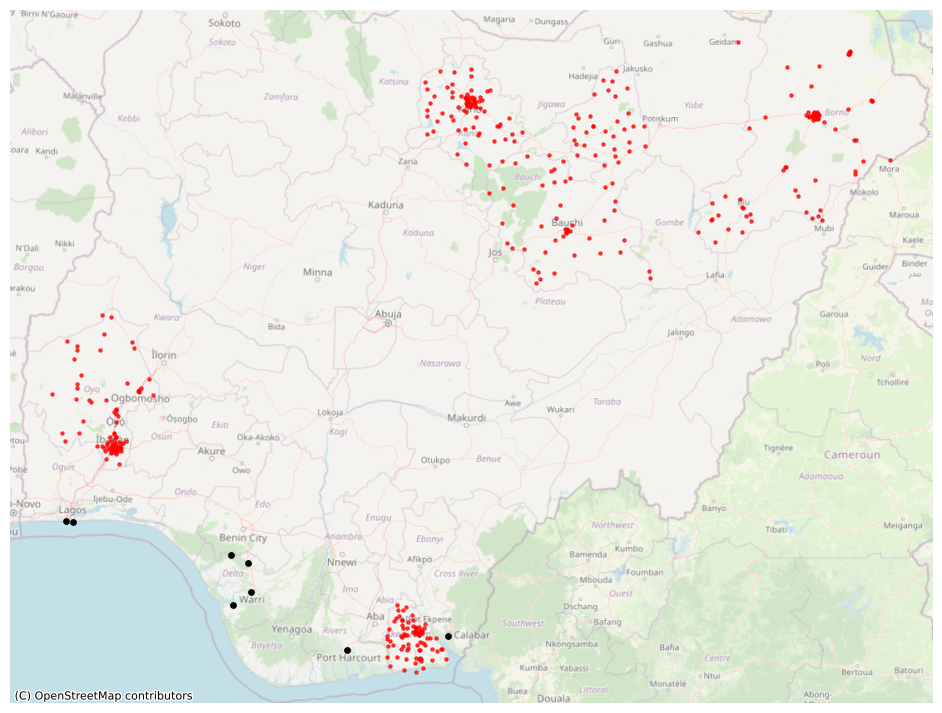

In [97]:
# create a visualisation of where the ports are

fig, ax = plt.subplots(figsize=(16, 9))

#plot the ports from the shapefile in black
port_df_26393['geometry'].plot(color = '#000000',
                               alpha=1,
                               markersize = 15,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 5,
                                       ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


ax.set_axis_off()
plt.show()

This plot shows that the Ports are concentrated at the South (near the coast of course) so clusters further North will have a greater distance to the ports than those further South.

This means we expect some very large distances from this calculation.

In [98]:
#Applying the function to find the distance to the nearest port for each cluster

clusters_26393_disp_port = calculate_nearest_distance_point(clusters_26393_disp, port_df_26393, facility_type='port')
clusters_26393_disp_port.crs = clusters_26393_disp['disp_coord'].crs

In [99]:
clusters_26393_disp['distance_to_port_m'].max()

1034270.0897089634

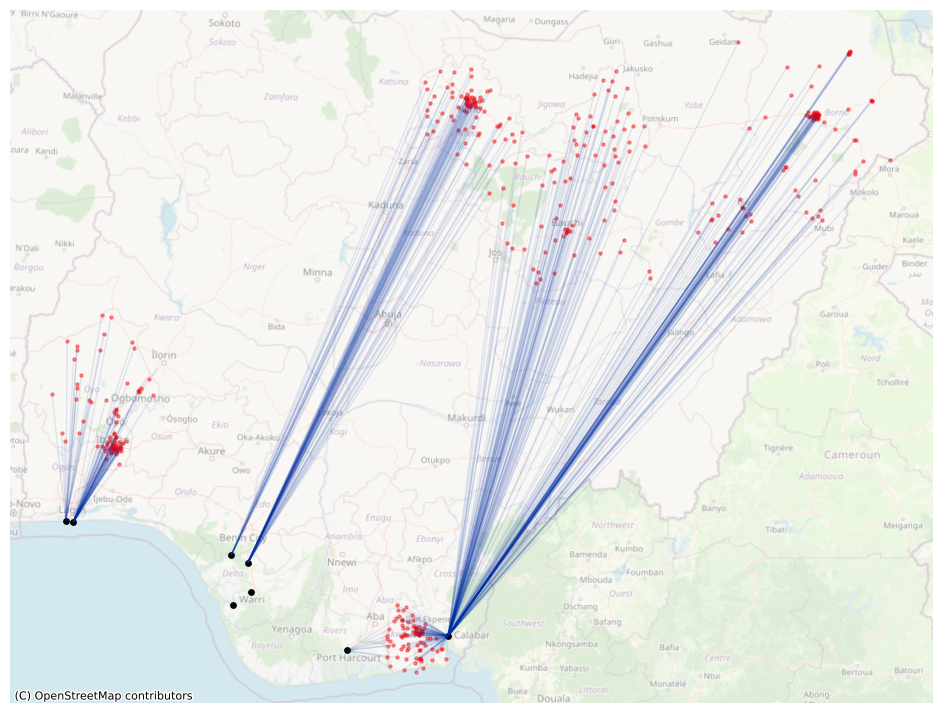

In [100]:
# create a data visualisation of the lines to the nearest port

fig, ax = plt.subplots(figsize=(16, 9))

#plot the Ports facilities in an black
port_df_26393['geometry'].plot(color = '#000000',
                               alpha=1,
                               markersize = 15,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.4,
                                       markersize = 5,
                                       ax = ax)

#plot the lines between the clusters and the roads in an opaque blue
clusters_26393_disp_port['line_to_port'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=0.1,
                                             ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp_port['line_to_port'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


ax.set_axis_off()
plt.show()

Interestingly we see that there are 2 ports which are not the closest for ANY cluster.

This distance would greatly benefit from calculating a *practical* distance to each port rather than an Ecludian distance. Here, we would need to use a **routing algorithm** and road data to estimate the distance travelled to each port. This would be especially useful in this case because ports are well-served by road networks, so while some clusters may be geographically closer to certain ports, it could be that using road networks, they need to travel a further distance than other clusters who are shown to be *'closer'* to a port here.

#### Airports

Like the state capitals shapefile, this shapefile folder has no .prj file so we **don't know the CRS of the coordinates**. Since all other WB data are in WGS 84, I will assume for now that this dataset is the same. But this is something I will **contact the WB data helpcenter about** since the CRS is not specified anywhere on the data download page.

.<br>
.<br>
.<br>
The dataset contains information on **13** airports in Nigeria


In [101]:
#read in the zip file from the WB source
url = requests.get('https://datacatalogfiles.worldbank.org/ddh-published/0041423/DR0051684/nga_airports.zip')

In [102]:
with open("airport_shapefile.zip", "wb") as file:
    file.write(url.content)

In [103]:
with zipfile.ZipFile("airport_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("airport_shapefile")

In [104]:
#Get the path to the shapefile within the unzipped folder
shapefile_path = "/content/airport_shapefile/Airports_AICD.shp"
#read that shapefile into a GeoDataFrame using GeoPandas
airport_df = gpd.read_file(shapefile_path)

In [105]:
airport_df.columns

Index(['Country', 'City', 'nat_07', 'int_07', 'Total', 'Alt_name',
       'CountryCod', 'LATITUDE', 'LONGITUDE', 'WB_Project', 'Main', 'P082806',
       'geometry'],
      dtype='object')

In [106]:
airport_df.head(2)

,Country,City,nat_07,int_07,Total,Alt_name,CountryCod,LATITUDE,LONGITUDE,WB_Project,Main,P082806,geometry
0,Nigeria,Port Harcourt,1038401.0,28340.0,1066741.0,PORTHARCOURT,NGA,4.778333,7.011667,0,0,0,POINT (7.01166 4.77831)
1,Nigeria,Calabar,237666.0,0.0,237666.0,CALABAR,NGA,4.950000,8.316667,0,0,0,POINT (8.31666 4.95001)


In [107]:
#THIS IS AN ASSUMPTION FOR NOW, NEED TO CONFIRM THE CRS.

airport_df.crs = "WGS 84"

In [108]:
airport_df_26393 = airport_df.to_crs(clusters_26393_disp.crs)

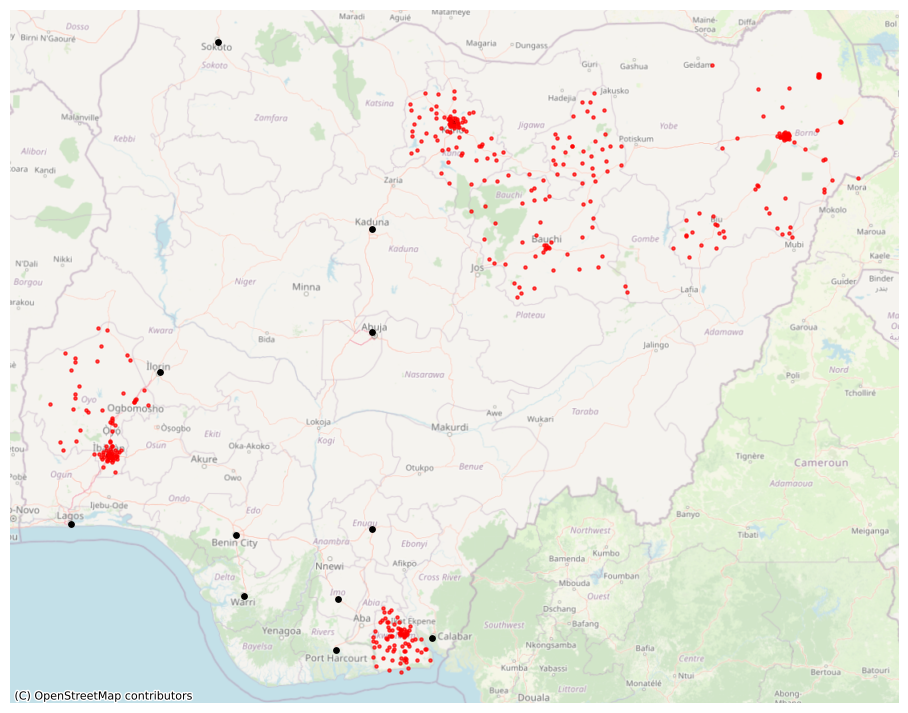

In [109]:
# create a visualisation of where the airports are

fig, ax = plt.subplots(figsize=(16, 9))

#plot the ports from the shapefile in black
airport_df_26393['geometry'].plot(color = '#000000',
                               alpha=1,
                               markersize = 15,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 5,
                                       ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


ax.set_axis_off()
plt.show()

These are more spread-out than the port distribution, but we still see that there is a greater proportion of airports in the South. The more sparce nature of these features could, again, give benefit to using a routing algorithm.

In [110]:
#Applying the function to find the distance to the nearest port for each cluster

clusters_26393_disp_airport = calculate_nearest_distance_point(clusters_26393_disp, airport_df_26393, facility_type='airport')
clusters_26393_disp_airport.crs = clusters_26393_disp['disp_coord'].crs

In [111]:
clusters_26393_disp['distance_to_airport_m'].max()

620172.0464175468

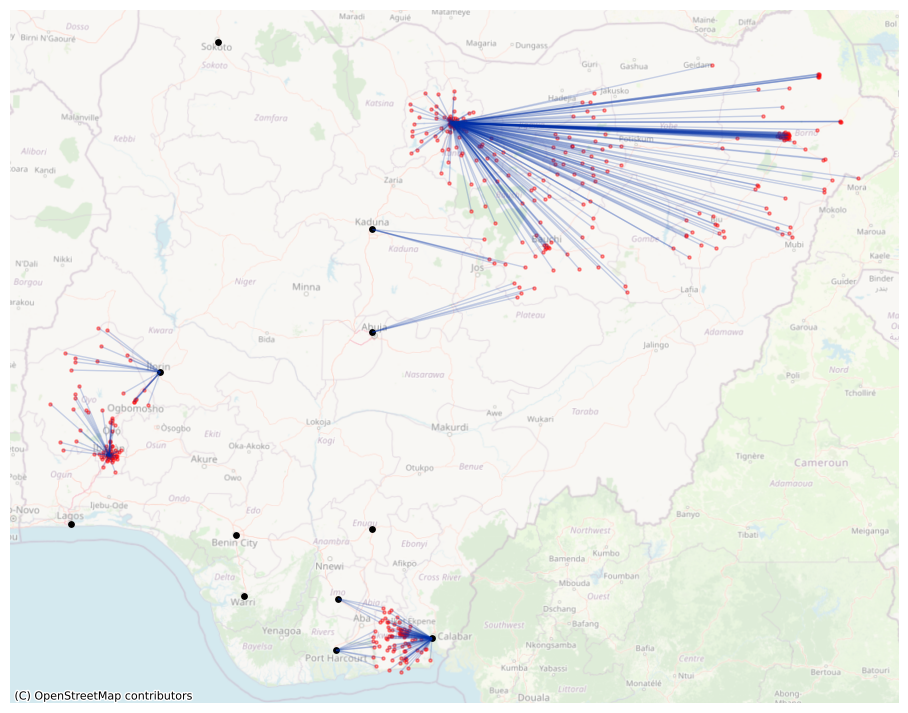

In [112]:
# create a data visualisation of the lines to the nearest airport

fig, ax = plt.subplots(figsize=(16, 9))

#plot the airports facilities in an black
airport_df_26393['geometry'].plot(color = '#000000',
                               alpha=1,
                               markersize = 15,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.4,
                                       markersize = 5,
                                       ax = ax)

#plot the lines between the clusters and the roads in an opaque blue
clusters_26393_disp_airport['line_to_airport'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=0.2,
                                             ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp_airport['line_to_airport'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


ax.set_axis_off()
plt.show()

#### Electricity Network

We have 2 datasets for this, so we will first load both datasets and compare the coverage of each dataset. The first dataset `elec_plan_df` contains information on existing AND planned transmission networks. The second dataset `elec_AICD_df` was from the AICD WB study and primarily considers existing medium and high voltage power transfer.

In [113]:
#read in the zip file from the WB source
url = requests.get('https://datacatalogfiles.worldbank.org/ddh-published/0042076/DR0052637/nigeriafinal.zip')

In [114]:
with open("elec_plan_shapefile.zip", "wb") as file:
    file.write(url.content)

In [115]:
with zipfile.ZipFile("elec_plan_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("elec_plan_shapefile")

In [116]:
#Get the path to the shapefile within the unzipped folder
shapefile_path = "/content/elec_plan_shapefile/Nigeria_final.shp"
#read that shapefile into a GeoDataFrame using GeoPandas
elec_plan_df = gpd.read_file(shapefile_path)

In [117]:
#read in the second zip file from the WB source
url = requests.get('https://datacatalogfiles.worldbank.org/ddh-published/0042323/DR0053008/nigeria-electricity-transmission-network.zip')

In [118]:
with open("elec_AICD_shapefile.zip", "wb") as file:
    file.write(url.content)

In [119]:
with zipfile.ZipFile("elec_AICD_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("elec_AICD_shapefile")

In [120]:
#Get the path to the shapefile within the unzipped folder
shapefile_path = "/content/elec_AICD_shapefile/Nigeria Electricity Transmission Network.shp"
#read that shapefile into a GeoDataFrame using GeoPandas
elec_AICD_df = gpd.read_file(shapefile_path)

In [121]:
print(f'For elec_plan_df the CRS is: {elec_plan_df.crs} for elec_AICD_df the CRS is: {elec_AICD_df.crs}')

For elec_plan_df the CRS is: EPSG:4326 for elec_AICD_df the CRS is: EPSG:4326


In [122]:
elec_plan_df_26393 = elec_plan_df.to_crs(clusters_26393_disp.crs)
elec_AICD_df_26393 = elec_AICD_df.to_crs(clusters_26393_disp.crs)

In [123]:
elec_plan_df_26393['status'].value_counts()
elec_existing_df_26393 = elec_plan_df_26393.loc[elec_plan_df_26393['status'] == 'Existing']

In [124]:
elec_existing_df_26393 = elec_plan_df_26393.loc[elec_plan_df_26393['status'] == 'Existing']

In [125]:
len(elec_existing_df_26393)

5410

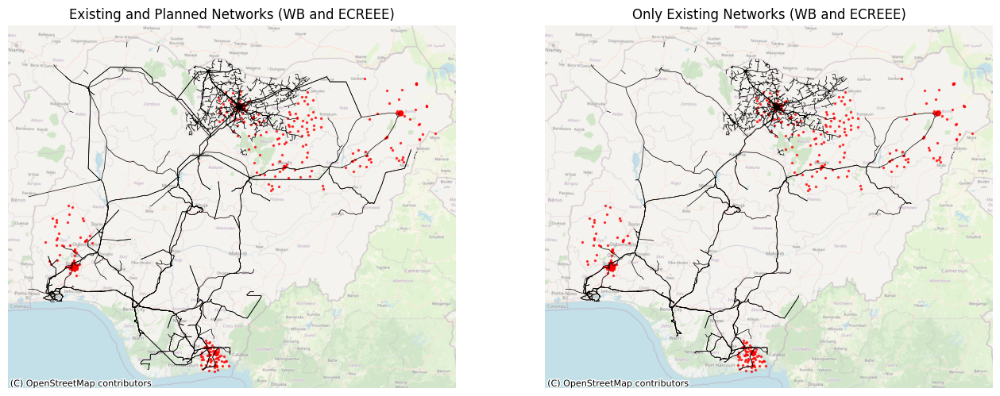

In [126]:
# create a visualisation of where the ports are

fig, ax = plt.subplots(1, 2, figsize=(16, 9))

#plot the ports from the shapefile in black
elec_plan_df_26393['geometry'].plot(color = '#000000',
                                     linewidth=0.5,
                                     ax = ax[0])

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 2,
                                       ax = ax[0])

cx.add_basemap(ax = ax[0],
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


#plot the ports from the shapefile in black
elec_existing_df_26393['geometry'].plot(color = '#000000',
                                     linewidth=0.5,
                                     ax = ax[1])

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 2,
                                       ax = ax[1])

cx.add_basemap(ax = ax[1],
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


ax[0].set_title('Existing and Planned Networks (WB and ECREEE)')
ax[1].set_title('Only Existing Networks (WB and ECREEE)')
ax[0].set_axis_off()
ax[1].set_axis_off()
plt.show()

We can see from this map that the **planned** networks in the WB and ECREEE dataset are relatively limited (157 lines). When we go on to look at the data available for all existing networks, we can see that the WB and ECREEE dataset has greater coverage of the transmission network.

In [127]:
elec_existing_ECREEE_df_26393 = elec_existing_df_26393.loc[elec_existing_df_26393['source'] == 'ECREEE']
elec_existing_ECREEE_df_26393.crs = elec_existing_df_26393.crs

In [128]:
elec_existing_df_26393['source'].value_counts()

World Bank Group    4983
ECREEE               423
World Bank             4
Name: source, dtype: int64

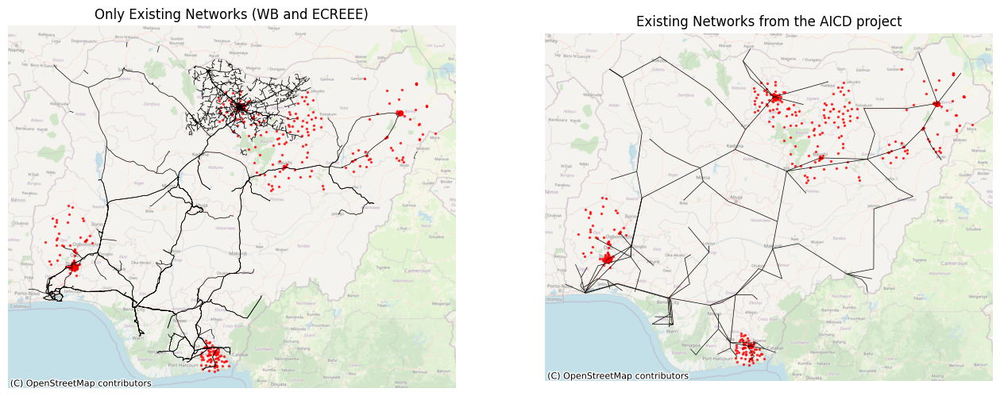

In [129]:
# create a visualisation of where the ports are

fig, ax = plt.subplots(1, 2, figsize=(16, 9))

#plot the ports from the shapefile in black
elec_existing_df_26393['geometry'].plot(color = '#000000',
                                     linewidth=0.5,
                                     ax = ax[0])

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 2,
                                       ax = ax[0])

cx.add_basemap(ax = ax[0],
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


#plot the ports from the shapefile in black
elec_AICD_df_26393['geometry'].plot(color = '#000000',
                                     linewidth=0.5,
                                     ax = ax[1])

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 2,
                                       ax = ax[1])

cx.add_basemap(ax = ax[1],
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


ax[0].set_title('Only Existing Networks (WB and ECREEE)')
ax[1].set_title('Existing Networks from the AICD project')
ax[0].set_axis_off()
ax[1].set_axis_off()
plt.show()

This map clearly shows that the WB and ECREEE dataset covers the transmission network much more extensively. This is likely because this dataset considers more than just the medium to high voltage transmission network. The ECREEE dataset also has data on the service area for the Kano Electricity Distribution Company (KEDCO). This firm has the license to distribute electricity in 3 states: Kano, Jigawa and Katsina, which explains the greater concentration of transmission networks in Central Northern Nigeria on the left pannel.

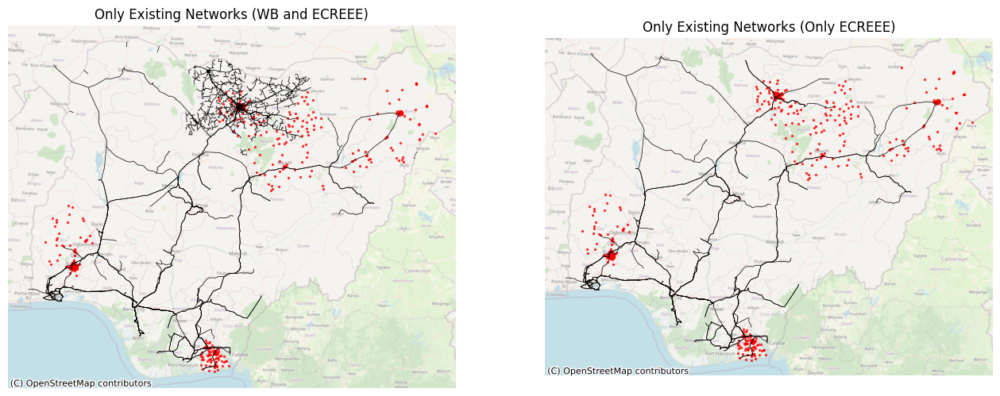

In [130]:
# create a visualisation of where the ports are

fig, ax = plt.subplots(1, 2, figsize=(16, 9))

#plot the ports from the shapefile in black
elec_existing_df_26393['geometry'].plot(color = '#000000',
                                     linewidth=0.5,
                                     ax = ax[0])

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 2,
                                       ax = ax[0])

cx.add_basemap(ax = ax[0],
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


#plot the ports from the shapefile in black
elec_existing_ECREEE_df_26393['geometry'].plot(color = '#000000',
                                     linewidth=0.5,
                                     ax = ax[1])

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 2,
                                       ax = ax[1])

cx.add_basemap(ax = ax[1],
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


ax[0].set_title('Only Existing Networks (WB and ECREEE)')
ax[1].set_title('Only Existing Networks (Only ECREEE)')
ax[0].set_axis_off()
ax[1].set_axis_off()
plt.show()

In [131]:
clusters_26393_disp_elec = calculate_nearest_distance_line(clusters_26393_disp, elec_existing_df_26393, facility_type = 'electricity')
clusters_26393_disp_elec.crs = clusters_26393_disp.crs

In [132]:
#Changing the CRS to
elec_existing_df_84 = elec_existing_df_26393.to_crs(road_ocha_84.crs)
clusters_84_disp_elec = clusters_26393_disp_elec.to_crs(road_ocha_84.crs)

In [133]:
#Creating an interractive map to view the calculated distances

m = folium.Map(location=[9.0820, 8.6753], zoom_start=6, control_scale=True)

folium.GeoJson(elec_existing_df_84['geometry'],
               name='Roads',
               style_function=lambda x: {'color': '#000000',
                                         'opacity': 0.4,
                                         'weight':1.5}).add_to(m)

#to avoid the ugly default markers, create a function to
def plotDot(point):
    if point.disp_coord is None:
      pass
    else:
      folium.CircleMarker(location=[point.disp_coord.y, point.disp_coord.x],
                          tooltip=[point.state, point.cluster],
                    radius=2,
                    opacity=1,
                    color = '#EE4B2B',
                    fill=True,).add_to(m)

#iterates through every row of the dataframe, plotting each point.
clusters_26393_disp.apply(plotDot, axis = 1)

# folium.GeoJson(clusters_26393_disp['disp_coord'],
#                name='Cluster Coordinates',
#                style_function=lambda x: {'color': 'red',
#                                          'weight':0.5}).add_to(m)

folium.GeoJson(clusters_84_disp_elec['line_to_electricity'],
               name='Lines to Road',
               style_function=lambda x: {'color': '#002fa7', 'opacity':0.7}).add_to(m)

folium.LayerControl().add_to(m)

#Get the HTML to create the map in a shareable web page
map_html = m._repr_html_()

m

#### Financial Services

The HOTOSM Financial Services dataset comes from an **OpenStreetMap** export of features within Nigeria which fit one of the following categories: `'mobile_money_agent', 'bureau_de_change' ,'bank', 'microfinance', 'atm', 'sacco', 'money_transfer', 'post_office'`

This dataset therefore only contains information on facilities registered on OpenStreetMap. It is regularly updated but may not cover smaller, less formal types of financial services which may not be registered on mapping. Therefore, this is not an exhaustive dataset.

In [134]:
#read in the zip file from the WB source
url = requests.get('https://export.hotosm.org/downloads/130c5517-bf9d-4734-912e-7ebfc41e89a9/hotosm_nga_financial_services_points_shp.zip')

In [135]:
with open("finance_shapefile.zip", "wb") as file:
    file.write(url.content)

In [136]:
with zipfile.ZipFile("finance_shapefile.zip", "r") as zip_ref:
    zip_ref.extractall("finance_shapefile")

In [137]:
#Get the path to the shapefile within the unzipped folder
shapefile_path = "/content/finance_shapefile/hotosm_nga_financial_services_points.shp"
#read that shapefile into a GeoDataFrame using GeoPandas
finance_df = gpd.read_file(shapefile_path)

In [138]:
finance_df

,osm_id,network,source,addrcity,amenity,name,addrfull,operator,geometry
0,3.179015e+08,NaN,NaN,NaN,post_office,Zaria Central Post Office,NaN,NaN,POINT (7.72042 11.10654)
1,5.417910e+08,NaN,NaN,NaN,bank,UBA,NaN,NaN,POINT (7.42078 10.46453)
2,5.417910e+08,NaN,NaN,NaN,bank,Union Bank,NaN,NaN,POINT (7.41991 10.47826)
3,5.418151e+08,NaN,NaN,NaN,bank,Bank PHB,NaN,NaN,POINT (7.41925 10.48282)
4,5.418151e+08,NaN,NaN,NaN,bank,Standard Chartered,NaN,NaN,POINT (7.41896 10.48419)
...,...,...,...,...,...,...,...,...,...
679,7.956234e+09,NaN,NaN,NaN,bank,"Central Bank of Nigeria, Calabar",NaN,NaN,POINT (8.32414 4.96356)
680,7.995711e+09,NaN,NaN,NaN,bank,BSIC,NaN,NaN,POINT (2.63135 6.48102)
681,8.038061e+09,NaN,NaN,NaN,bank,BGFI,NaN,NaN,POINT (2.60847 6.50916)
682,8.065456e+09,NaN,NaN,NaN,post_office,Dongaco,NaN,NaN,POINT (2.63455 6.38338)


In [139]:
finance_df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [140]:
finance_df_26393 = finance_df.to_crs(clusters_26393_disp.crs)

In [141]:
finance_df['amenity'].value_counts()

bank                497
post_office          95
atm                  66
money_transfer       14
bureau_de_change     12
Name: amenity, dtype: int64

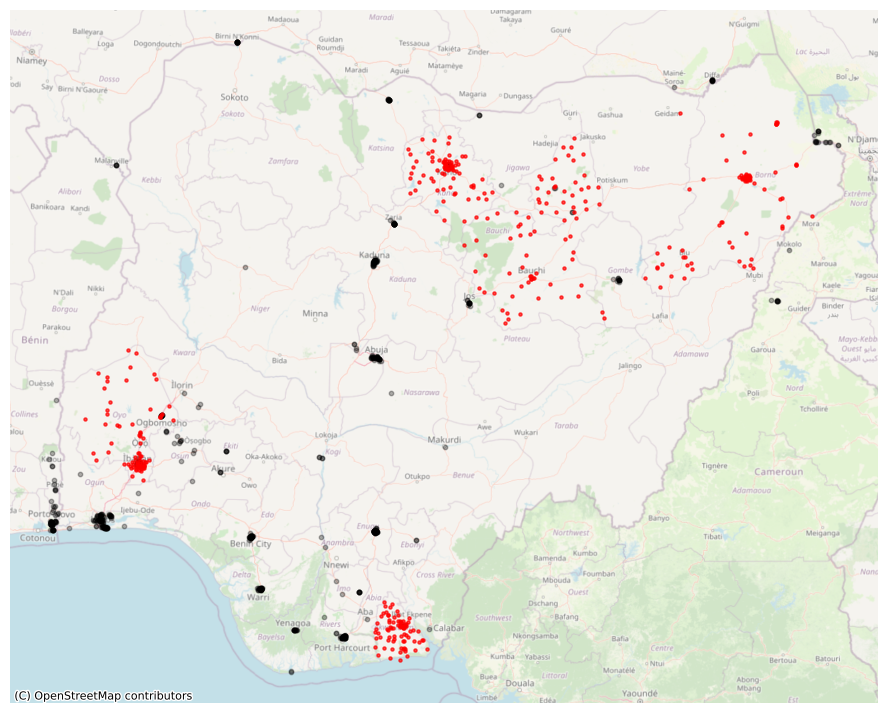

In [142]:
# create a visualisation of where the financial services are

fig, ax = plt.subplots(figsize=(16, 9))

#plot the ports from the shapefile in black
finance_df_26393['geometry'].plot(color = '#000000',
                               alpha=0.3,
                               markersize = 10,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.7,
                                       markersize = 5,
                                       ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp.crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.7)


ax.set_axis_off()
plt.show()

In [143]:
clusters_26393_disp_finance = calculate_nearest_distance_point(clusters_26393_disp, finance_df_26393, facility_type='finance')
clusters_26393_disp_finance.crs = clusters_26393_disp['disp_coord'].crs

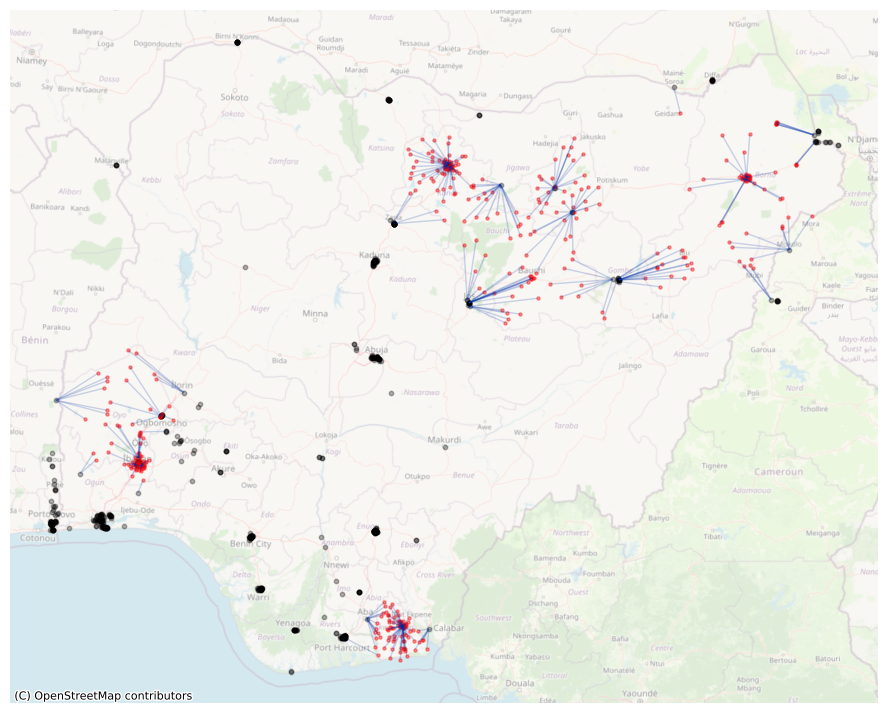

In [144]:
# create a data visualisation of the lines to the nearest financial service

fig, ax = plt.subplots(figsize=(16, 9))

#plot the airports facilities in an black
finance_df_26393['geometry'].plot(color = '#000000',
                               alpha=0.3,
                               markersize = 10,
                               ax = ax)

#Plot the displaced cluster coordinates (in red)
clusters_26393_disp['disp_coord'].plot(color = 'red',
                                       alpha=0.4,
                                       markersize = 5,
                                       ax = ax)

#plot the lines between the clusters and the roads in an opaque blue
clusters_26393_disp_finance['line_to_finance'].plot(color = '#002fa7',
                                             linewidth=1,
                                             alpha=0.2,
                                             ax = ax)

cx.add_basemap(ax,
               crs = clusters_26393_disp_finance['line_to_finance'].crs,
               source=cx.providers.OpenStreetMap.Mapnik,
               alpha=0.5)


ax.set_axis_off()
plt.show()

In [145]:
clusters_26393_disp.columns

Index(['index', 'state', 'cluster', 'urbrur', 'fahe_lat', 'fahe_long',
       'geometry', 'buffer', 'disp_coord', 'no_geom', 'distance_to_any_road_m',
       'line_to_any_road', 'distance_to_track_road_m', 'line_to_track_road',
       'distance_to_federal_road_m', 'line_to_federal_road',
       'distance_to_paved_road_m', 'line_to_paved_road',
       'distance_to_health_m', 'line_to_health', 'distance_to_educ_m',
       'line_to_educ', 'distance_to_state_capital_m', 'line_to_state_capital',
       'distance_to_irrigation_m', 'line_to_irrigation', 'distance_to_port_m',
       'line_to_port', 'distance_to_airport_m', 'line_to_airport',
       'distance_to_electricity_m', 'line_to_electricity',
       'distance_to_finance_m', 'line_to_finance'],
      dtype='object')

### Creating the final output

To create the final output I need to do a few things:
1. Keep only the variables of intterest, getting rid of illustrative lines etc.
2. Create a lat and long variable for the displaced coordinates.
3. Swap the lat and long for problematic clusters so that this dataset has their correct original coordinates

4. Converting the dataset into a .dta file

#### 1.

In [146]:
clusters_26393_disp.columns

Index(['index', 'state', 'cluster', 'urbrur', 'fahe_lat', 'fahe_long',
       'geometry', 'buffer', 'disp_coord', 'no_geom', 'distance_to_any_road_m',
       'line_to_any_road', 'distance_to_track_road_m', 'line_to_track_road',
       'distance_to_federal_road_m', 'line_to_federal_road',
       'distance_to_paved_road_m', 'line_to_paved_road',
       'distance_to_health_m', 'line_to_health', 'distance_to_educ_m',
       'line_to_educ', 'distance_to_state_capital_m', 'line_to_state_capital',
       'distance_to_irrigation_m', 'line_to_irrigation', 'distance_to_port_m',
       'line_to_port', 'distance_to_airport_m', 'line_to_airport',
       'distance_to_electricity_m', 'line_to_electricity',
       'distance_to_finance_m', 'line_to_finance'],
      dtype='object')

In [147]:
#keeping only the distances and relevant identifier variables
keep_cols = ['index', 'state', 'cluster', 'urbrur', 'fahe_lat', 'fahe_long', 'disp_coord',
             'distance_to_any_road_m', 'distance_to_track_road_m', 'distance_to_federal_road_m',
             'distance_to_paved_road_m', 'distance_to_health_m', 'distance_to_educ_m',
             'distance_to_state_capital_m', 'distance_to_irrigation_m', 'distance_to_port_m',
             'distance_to_airport_m', 'distance_to_electricity_m', 'distance_to_finance_m']
clusters_final = clusters_26393_disp[keep_cols]

#### 2.

In [148]:
#converting to WGS 84 for the final displaced long and lat variables
clusters_final = clusters_final.to_crs("WGS 84")

In [149]:
#creating the displaced long and lat variables from the Shapely point objects (long = x, lat = y)
clusters_final['fahe_long_disp'] = clusters_final['disp_coord'].x
clusters_final['fahe_lat_disp'] = clusters_final['disp_coord'].y

In [150]:
#can now drop the Point object column since we have the displaced coordinates already.
clusters_final = clusters_final.drop('disp_coord', axis=1)

#### 3.

In [151]:
# The clusters with swapped long/lat are [339, 340, 341]

swap_coords = [339, 340, 341]

#create a copy of their long and lats to reference
copy = clusters_final.loc[clusters_final['cluster'].isin(swap_coords), ['fahe_lat', 'fahe_long']].copy()

#Here we are locating the clusters in swap_coords, and replacing their long and lats with the lats and longs from our
# copy of their original values. This means we retain their original values in 'copy' so after swapping one, we can
# still swap the other.
clusters_final.loc[clusters_final['cluster'].isin(swap_coords), 'fahe_lat'] = copy['fahe_long']
clusters_final.loc[clusters_final['cluster'].isin(swap_coords), 'fahe_long'] = copy['fahe_lat']

In [152]:
clusters_final

,index,state,cluster,urbrur,fahe_lat,fahe_long,distance_to_any_road_m,distance_to_track_road_m,distance_to_federal_road_m,distance_to_paved_road_m,distance_to_health_m,distance_to_educ_m,distance_to_state_capital_m,distance_to_irrigation_m,distance_to_port_m,distance_to_airport_m,distance_to_electricity_m,distance_to_finance_m,fahe_long_disp,fahe_lat_disp
0,0,bauchi,1.0,rural,10.22240,10.61791,8147.399106,8147.399106,13544.699285,57274.547463,3221.205288,50144.342284,58735.065642,0.000000,631874.278836,303128.723793,12310.247027,53920.994530,10.605492,10.197063
1,1,bauchi,2.0,rural,9.81436,10.92451,205.725613,205.725613,32486.538867,22387.181634,5324.237715,27602.184215,60404.851929,1400.020289,607062.852982,360263.876295,34464.027714,58084.500491,10.934521,9.787923
2,2,bauchi,3.0,urban,9.68761,10.95771,2272.975618,2272.975618,33938.093171,16560.394519,423.205851,29514.955968,69177.282782,0.000000,599421.839659,368925.934913,36455.560121,66725.591233,10.956459,9.697046
3,3,bauchi,4.0,rural,10.05812,10.28256,1301.515477,1301.515477,26498.982876,59621.336821,3863.860008,88582.727864,64527.731002,2310.817141,600496.641439,292879.227382,25437.909559,92216.898265,10.293290,10.018261
4,4,bauchi,5.0,rural,10.48538,9.67225,586.681225,586.681225,19581.819776,13458.858485,551.123995,121651.200780,20020.668485,3406.247919,629128.598845,212435.805226,24550.590234,108300.151350,9.700838,10.476230
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,395,oyo,396.0,urban,8.75096,3.26754,14261.355649,14261.355649,123844.428720,31398.372281,512.928428,71868.402961,147410.543064,2981.658921,261785.802943,146690.812153,95964.200962,84597.753485,3.270962,8.754290
396,396,oyo,397.0,urban,8.68862,3.40859,627.055195,627.055195,108606.025103,17419.747478,450.147471,86858.414467,132107.163585,1767.016367,255167.094787,131533.467444,84726.356780,93641.619712,3.399168,8.693626
397,397,oyo,398.0,urban,8.65261,3.39345,1452.712744,1452.712744,104509.315087,12306.455621,268.099630,89719.195894,130891.257115,844.538097,249314.783519,130528.515315,79006.956919,91563.601558,3.402123,8.641186
398,398,oyo,399.0,urban,8.29819,4.34744,1355.400212,20532.270002,1355.400212,13841.513023,1472.380966,12689.705133,33373.356081,1378.502638,235748.577215,36938.923124,28808.027394,19382.144669,4.347709,8.284089


#### 4.

In [153]:
clusters_final.to_stata('Displaced_Cluster_Coordinates_with_Distances.dta')

### Distribution of Distances

Now we will create a function to show the distribution of the distances to features.

In [154]:
import seaborn as sns

In [155]:
clusters_final.columns

Index(['index', 'state', 'cluster', 'urbrur', 'fahe_lat', 'fahe_long',
       'distance_to_any_road_m', 'distance_to_track_road_m',
       'distance_to_federal_road_m', 'distance_to_paved_road_m',
       'distance_to_health_m', 'distance_to_educ_m',
       'distance_to_state_capital_m', 'distance_to_irrigation_m',
       'distance_to_port_m', 'distance_to_airport_m',
       'distance_to_electricity_m', 'distance_to_finance_m', 'fahe_long_disp',
       'fahe_lat_disp'],
      dtype='object')

In [156]:
def plot_distribution(selected_feature):
  fig, ax1 = plt.subplots(figsize=(16, 9))


  #plot the histogram
  sns.histplot(clusters_final[f'distance_to_{selected_feature}_m'],
               kde=False,
               color='#7dba94',
               edgecolor = '#7dba94',
               ax = ax1)

  #something strange was happening before so i needed to create a second axes for the second plot.
  ax2 = ax1.twinx()
  #plot the density line
  sns.kdeplot(clusters_final[f'distance_to_{selected_feature}_m'],
              color='#807dba',
              linewidth = 3,
              ax=ax2)
  ax1.set_xlabel(f'Distance to {selected_feature} (km)')
  # Modify x-axis ticks and labels to show distance in km
  plt.xticks(plt.xticks()[0], plt.xticks()[0] / 1000)
  plt.xlim(0)

  ax1.set_ylabel('Frequency')
  #hide the second axis.
  ax2.set_axis_off()
  fig.suptitle(f'Distribution of distances to {selected_feature}')
  plt.show()

The Options for the different distributions to plot are:
`any_road`, `track_road`, `federal_road`, `paved_road`, `health`, `educ`, `state_capital`, `irrigation`, `port`,`airport`, `electricity`,`finance`.

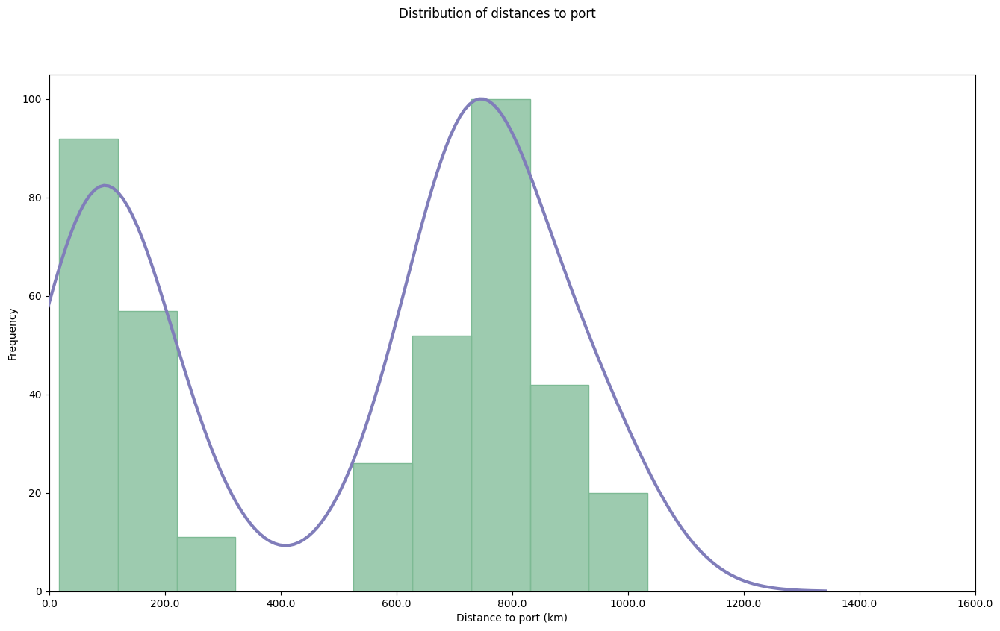

In [157]:
plot_distribution(selected_feature = 'port')

In [158]:
import ipywidgets as widgets
from ipywidgets import interactive

In [159]:
#or if we want a dropdown of the options.
variable_dropdown = widgets.Dropdown(options=['any_road', 'track_road', 'federal_road', 'paved_road', 'health', 'educ', 'state_capital', 'irrigation', 'port', 'airport', 'electricity', 'finance'],
                                     description='Select Feature:')

interactive_plot = interactive(plot_distribution, selected_feature=variable_dropdown)
output = interactive_plot.children[-1]
interactive_plot

interactive(children=(Dropdown(description='Select Feature:', options=('any_road', 'track_road', 'federal_road…